<a href="https://colab.research.google.com/github/vishakhasingh2003/5-ML_DS-FarmImpact/blob/main/Correlation_SHAP_STL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import gdown
file_id = '1MCmntA3BOquC7BWxLcYDItohDgTPRKx8'
url = f'https://drive.google.com/uc?id={file_id}'
output = 'Crop_Data_Final.csv'
gdown.download(url, output, quiet=False)

import gdown
file_id = '1KXMl4EVNofFnGsypt1UpZ4GJL6pGLJCe'
url = f'https://drive.google.com/uc?id={file_id}'
output = 'maharashtra_aggregate_1966_2017.csv'
gdown.download(url, output, quiet=False)



Downloading...
From: https://drive.google.com/uc?id=1MCmntA3BOquC7BWxLcYDItohDgTPRKx8
To: /content/Crop_Data_Final.csv
100%|██████████| 214k/214k [00:00<00:00, 32.4MB/s]
Downloading...
From: https://drive.google.com/uc?id=1KXMl4EVNofFnGsypt1UpZ4GJL6pGLJCe
To: /content/maharashtra_aggregate_1966_2017.csv
100%|██████████| 277k/277k [00:00<00:00, 79.2MB/s]


'maharashtra_aggregate_1966_2017.csv'

# Aggregate

In [ ]:
import pandas as pd
from tabulate import tabulate

# Load dataset
file_path = "/content/maharashtra_aggregate_1966_2017.csv"
df = pd.read_csv(file_path)

# Drop non-numeric columns for correlation analysis
df_numeric = df.select_dtypes(include=['number'])

# Get correlations of Yield and Production with all other attributes
corr_yield = df_numeric.corr()['Yield']
corr_production = df_numeric.corr()['Production']

# Combine into a single DataFrame
corr_matrix = pd.DataFrame({
    'Yield': corr_yield,
    'Production': corr_production
}).drop(index=['Yield', 'Production'])  # Remove self-correlations

# Display correlation matrix in tabular format
print(tabulate(corr_matrix, headers='keys', tablefmt='fancy_grid', floatfmt=".2f"))


╒════════════════════════════════════════════════╤═════════╤══════════════╕
│                                                │   Yield │   Production │
╞════════════════════════════════════════════════╪═════════╪══════════════╡
│ Year                                           │    0.40 │         0.49 │
├────────────────────────────────────────────────┼─────────┼──────────────┤
│ Area                                           │    0.19 │         0.55 │
├────────────────────────────────────────────────┼─────────┼──────────────┤
│ Irrigated Area                                 │    0.21 │         0.21 │
├────────────────────────────────────────────────┼─────────┼──────────────┤
│ Annual Rainfall                                │   -0.24 │        -0.29 │
├────────────────────────────────────────────────┼─────────┼──────────────┤
│ NITROGEN CONSUMPTION (tons)                    │    0.62 │         0.68 │
├────────────────────────────────────────────────┼─────────┼──────────────┤
│ NITROGEN S

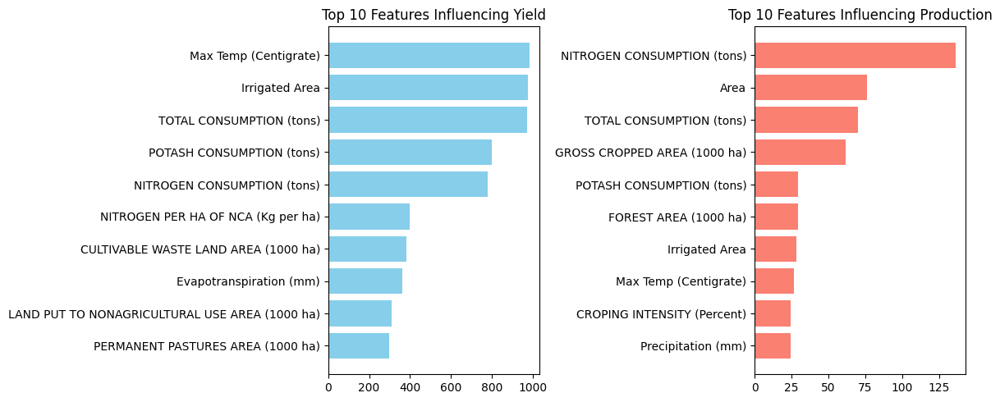

In [ ]:
import pandas as pd
import shap
import matplotlib.pyplot as plt
import xgboost as xgb

# Load dataset
file_path = "/content/maharashtra_aggregate_1966_2017.csv"
df = pd.read_csv(file_path)

# Drop the 'Year' column
df = df.drop(columns=['Year'])

# Selecting features (excluding non-numeric and target columns)
features = df.select_dtypes(include=['number']).drop(columns=['Yield', 'Production'])

# Targets
y_yield = df['Yield']
y_production = df['Production']

# Train XGBoost models
model_yield = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, random_state=42)
model_production = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, random_state=42)

model_yield.fit(features, y_yield)
model_production.fit(features, y_production)

# Explain models using SHAP
explainer_yield = shap.Explainer(model_yield, features)
explainer_production = shap.Explainer(model_production, features)

shap_values_yield = explainer_yield(features)
shap_values_production = explainer_production(features)

# Calculate mean absolute SHAP values for feature importance
importance_yield = pd.DataFrame({
    'Feature': features.columns,
    'Importance': shap_values_yield.abs.mean(0).values
}).sort_values(by='Importance', ascending=False).head(10)

importance_production = pd.DataFrame({
    'Feature': features.columns,
    'Importance': shap_values_production.abs.mean(0).values
}).sort_values(by='Importance', ascending=False).head(10)

# Plot bar graphs for top 10 influential features
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.barh(importance_yield['Feature'], importance_yield['Importance'], color='skyblue')
plt.gca().invert_yaxis()
plt.title('Top 10 Features Influencing Yield')

plt.subplot(1, 2, 2)
plt.barh(importance_production['Feature'], importance_production['Importance'], color='salmon')
plt.gca().invert_yaxis()
plt.title('Top 10 Features Influencing Production')

plt.tight_layout()
plt.show()

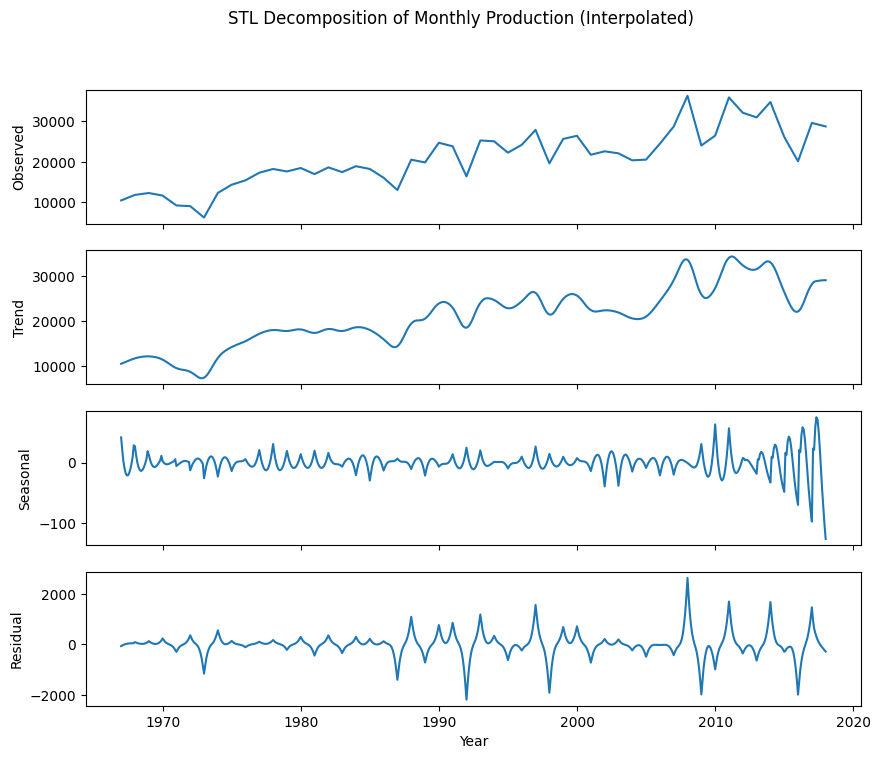

In [ ]:
# Import necessary libraries
import pandas as pd
from statsmodels.tsa.seasonal import STL
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/content/maharashtra_aggregate_1966_2017.csv'  # Update path if needed
data = pd.read_csv(file_path)

# Convert 'Year' to datetime format and set as the index
data['Year'] = pd.to_datetime(data['Year'], format='%Y')
data.set_index('Year', inplace=True)

# Aggregate production data by year, then interpolate to monthly frequency
yearly_production = data['Production'].resample('YE').sum()
monthly_production = yearly_production.resample('ME').interpolate()

# Apply STL decomposition with a seasonal period of 13 (for monthly seasonality)
stl = STL(monthly_production, seasonal=13)
result = stl.fit()

# Plot the decomposition results
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(10, 8), sharex=True)
ax1.plot(result.observed, label='Observed')
ax1.set_ylabel('Observed')
ax2.plot(result.trend, label='Trend')
ax2.set_ylabel('Trend')
ax3.plot(result.seasonal, label='Seasonal')
ax3.set_ylabel('Seasonal')
ax4.plot(result.resid, label='Residual')
ax4.set_ylabel('Residual')
ax4.set_xlabel('Year')
plt.suptitle('STL Decomposition of Monthly Production (Interpolated)')
plt.show()


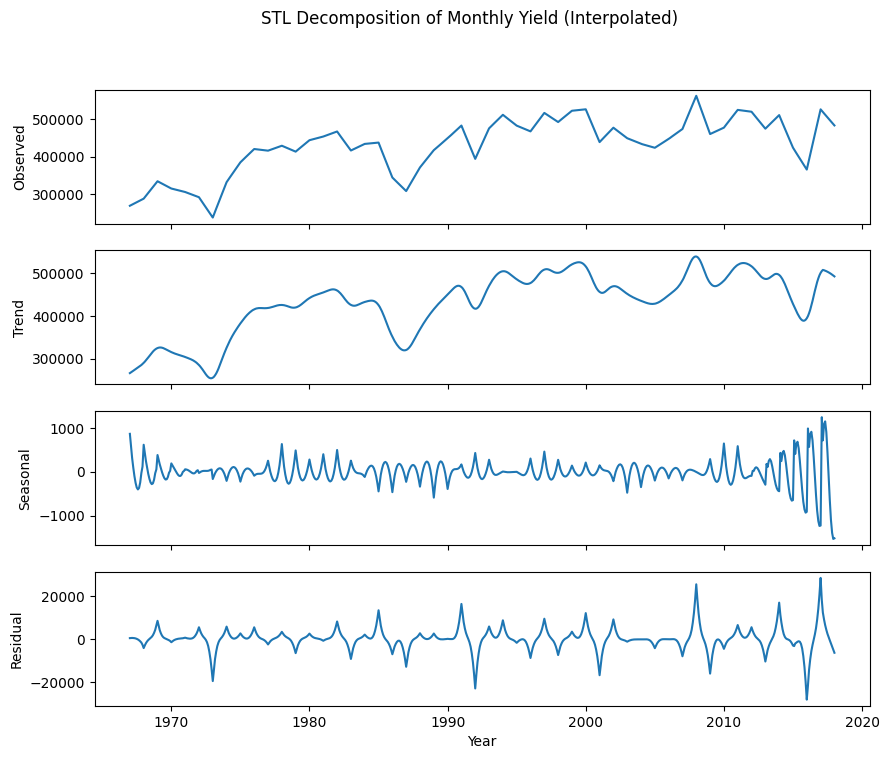

In [ ]:
# Import necessary libraries
import pandas as pd
from statsmodels.tsa.seasonal import STL
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/content/maharashtra_aggregate_1966_2017.csv'  # Update path if needed
data = pd.read_csv(file_path)

# Convert 'Year' to datetime format and set as the index
data['Year'] = pd.to_datetime(data['Year'], format='%Y')
data.set_index('Year', inplace=True)

# Aggregate production data by year, then interpolate to monthly frequency
yearly_production = data['Yield'].resample('YE').sum()
monthly_production = yearly_production.resample('ME').interpolate()

# Apply STL decomposition with a seasonal period of 13 (for monthly seasonality)
stl = STL(monthly_production, seasonal=13)
result = stl.fit()

# Plot the decomposition results
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(10, 8), sharex=True)
ax1.plot(result.observed, label='Observed')
ax1.set_ylabel('Observed')
ax2.plot(result.trend, label='Trend')
ax2.set_ylabel('Trend')
ax3.plot(result.seasonal, label='Seasonal')
ax3.set_ylabel('Seasonal')
ax4.plot(result.resid, label='Residual')
ax4.set_ylabel('Residual')
ax4.set_xlabel('Year')
plt.suptitle('STL Decomposition of Monthly Yield (Interpolated)')
plt.show()


# Crop

In [ ]:
import pandas as pd
import numpy as np
from tabulate import tabulate

# Load the dataset
df = pd.read_csv('/content/Crop_Data_Final.csv')

# Define crop columns
crop_columns = {
    'Rice': ['RICE AREA (1000 ha)', 'RICE PRODUCTION (1000 tons)', 'RICE YIELD (Kg per ha)'],
    'Wheat': ['WHEAT AREA (1000 ha)', 'WHEAT PRODUCTION (1000 tons)', 'WHEAT YIELD (Kg per ha)'],
    'Sorghum': ['SORGHUM AREA (1000 ha)', 'SORGHUM PRODUCTION (1000 tons)', 'SORGHUM YIELD (Kg per ha)'],
    'Pearl Millet': ['PEARL MILLET AREA (1000 ha)', 'PEARL MILLET PRODUCTION (1000 tons)', 'PEARL MILLET YIELD (Kg per ha)'],
    'Maize': ['MAIZE AREA (1000 ha)', 'MAIZE PRODUCTION (1000 tons)', 'MAIZE YIELD (Kg per ha)'],
    'Chickpea': ['CHICKPEA AREA (1000 ha)', 'CHICKPEA PRODUCTION (1000 tons)', 'CHICKPEA YIELD (Kg per ha)'],
    'Pigeonpea': ['PIGEONPEA AREA (1000 ha)', 'PIGEONPEA PRODUCTION (1000 tons)', 'PIGEONPEA YIELD (Kg per ha)'],
    'Minor Pulses': ['MINOR PULSES AREA (1000 ha)', 'MINOR PULSES PRODUCTION (1000 tons)', 'MINOR PULSES YIELD (Kg per ha)'],
    'Groundnut': ['GROUNDNUT AREA (1000 ha)', 'GROUNDNUT PRODUCTION (1000 tons)', 'GROUNDNUT YIELD (Kg per ha)'],
    'Sesamum': ['SESAMUM AREA (1000 ha)', 'SESAMUM PRODUCTION (1000 tons)', 'SESAMUM YIELD (Kg per ha)'],
    'Oilseeds': ['OILSEEDS AREA (1000 ha)', 'OILSEEDS PRODUCTION (1000 tons)', 'OILSEEDS YIELD (Kg per ha)'],
    'Sugarcane': ['SUGARCANE AREA (1000 ha)', 'SUGARCANE PRODUCTION (1000 tons)', 'SUGARCANE YIELD (Kg per ha)'],
    'Cotton': ['COTTON AREA (1000 ha)', 'COTTON PRODUCTION (1000 tons)', 'COTTON YIELD (Kg per ha)'],
}

other_attributes = [
    'NITROGEN SHARE IN NPK (Percent)', 'PHOSPHATE SHARE IN NPK (Percent)', 'POTASH SHARE IN NPK (Percent)',
    'NITROGEN PER HA OF NCA (Kg per ha)', 'NITROGEN PER HA OF GCA (Kg per ha)',
    'PHOSPHATE PER HA OF NCA (Kg per ha)', 'PHOSPHATE PER HA OF GCA (Kg per ha)',
    'POTASH PER HA OF NCA (Kg per ha)', 'POTASH PER HA OF GCA (Kg per ha)',
    'Min Temp (Centigrate)', 'Max Temp (Centigrate)', 'Precipitation (mm)', 'Irrigated Area', 'Annual Rainfall'
]

correlation_results = []

for crop, columns in crop_columns.items():
    if len(columns) >= 3:  # Ensure the crop has yield and production columns
        yield_col = columns[2]
        production_col = columns[1]
        relevant_columns = [yield_col, production_col] + other_attributes
        crop_df = df[relevant_columns].corr()
        correlations = crop_df.loc[[yield_col, production_col], other_attributes]
        print(f"Correlation Matrix for {crop} (Yield & Production vs Other Attributes):\n")
        print(tabulate(correlations, headers='keys', tablefmt='grid'))
        print("\n" + "-" * 80 + "\n")


Correlation Matrix for Rice (Yield & Production vs Other Attributes):

+-----------------------------+-----------------------------------+------------------------------------+---------------------------------+--------------------------------------+--------------------------------------+---------------------------------------+---------------------------------------+------------------------------------+------------------------------------+-------------------------+-------------------------+----------------------+------------------+-------------------+
|                             |   NITROGEN SHARE IN NPK (Percent) |   PHOSPHATE SHARE IN NPK (Percent) |   POTASH SHARE IN NPK (Percent) |   NITROGEN PER HA OF NCA (Kg per ha) |   NITROGEN PER HA OF GCA (Kg per ha) |   PHOSPHATE PER HA OF NCA (Kg per ha) |   PHOSPHATE PER HA OF GCA (Kg per ha) |   POTASH PER HA OF NCA (Kg per ha) |   POTASH PER HA OF GCA (Kg per ha) |   Min Temp (Centigrate) |   Max Temp (Centigrate) |   Precipitation (mm) 

In [ ]:
import pandas as pd
import numpy as np
from tabulate import tabulate

# Load the dataset
df = pd.read_csv('/content/Crop_Data_Final.csv')

# Define crop columns
crop_columns = {
    'Rice': ['RICE AREA (1000 ha)', 'RICE PRODUCTION (1000 tons)', 'RICE YIELD (Kg per ha)'],
    'Wheat': ['WHEAT AREA (1000 ha)', 'WHEAT PRODUCTION (1000 tons)', 'WHEAT YIELD (Kg per ha)'],
    'Sorghum': ['SORGHUM AREA (1000 ha)', 'SORGHUM PRODUCTION (1000 tons)', 'SORGHUM YIELD (Kg per ha)'],
    'Pearl Millet': ['PEARL MILLET AREA (1000 ha)', 'PEARL MILLET PRODUCTION (1000 tons)', 'PEARL MILLET YIELD (Kg per ha)'],
    'Maize': ['MAIZE AREA (1000 ha)', 'MAIZE PRODUCTION (1000 tons)', 'MAIZE YIELD (Kg per ha)'],
    'Chickpea': ['CHICKPEA AREA (1000 ha)', 'CHICKPEA PRODUCTION (1000 tons)', 'CHICKPEA YIELD (Kg per ha)'],
    'Pigeonpea': ['PIGEONPEA AREA (1000 ha)', 'PIGEONPEA PRODUCTION (1000 tons)', 'PIGEONPEA YIELD (Kg per ha)'],
    'Minor Pulses': ['MINOR PULSES AREA (1000 ha)', 'MINOR PULSES PRODUCTION (1000 tons)', 'MINOR PULSES YIELD (Kg per ha)'],
    'Groundnut': ['GROUNDNUT AREA (1000 ha)', 'GROUNDNUT PRODUCTION (1000 tons)', 'GROUNDNUT YIELD (Kg per ha)'],
    'Sesamum': ['SESAMUM AREA (1000 ha)', 'SESAMUM PRODUCTION (1000 tons)', 'SESAMUM YIELD (Kg per ha)'],
    'Oilseeds': ['OILSEEDS AREA (1000 ha)', 'OILSEEDS PRODUCTION (1000 tons)', 'OILSEEDS YIELD (Kg per ha)'],
    'Sugarcane': ['SUGARCANE AREA (1000 ha)', 'SUGARCANE PRODUCTION (1000 tons)', 'SUGARCANE YIELD (Kg per ha)'],
    'Cotton': ['COTTON AREA (1000 ha)', 'COTTON PRODUCTION (1000 tons)', 'COTTON YIELD (Kg per ha)'],
}

# Define climatic and other attributes
other_attributes = [
    'NITROGEN SHARE IN NPK (Percent)', 'PHOSPHATE SHARE IN NPK (Percent)', 'POTASH SHARE IN NPK (Percent)',
    'NITROGEN PER HA OF NCA (Kg per ha)', 'NITROGEN PER HA OF GCA (Kg per ha)',
    'PHOSPHATE PER HA OF NCA (Kg per ha)', 'PHOSPHATE PER HA OF GCA (Kg per ha)',
    'POTASH PER HA OF NCA (Kg per ha)', 'POTASH PER HA OF GCA (Kg per ha)',
    'Min Temp (Centigrate)', 'Max Temp (Centigrate)', 'Precipitation (mm)', 'Irrigated Area', 'Annual Rainfall'
]

# Initialize dataframe to store correlations
correlation_df = pd.DataFrame(index=other_attributes)

# Calculate correlations for each crop's yield and production
for crop, columns in crop_columns.items():
    if len(columns) >= 3:
        yield_col = columns[2]
        production_col = columns[1]
        relevant_columns = [yield_col, production_col] + other_attributes
        crop_df = df[relevant_columns].corr()

        # Get mean correlation for yield & production with other attributes
        mean_correlation = crop_df.loc[[yield_col, production_col], other_attributes].mean()

        # Add to final dataframe
        correlation_df[crop] = mean_correlation

# Display the combined correlation matrix
print("\nCombined Correlation Matrix (Crops vs Climatic/Other Attributes):\n")
print(tabulate(correlation_df, headers='keys', tablefmt='grid'))



Combined Correlation Matrix (Crops vs Climatic/Other Attributes):

+-------------------------------------+------------+------------+-------------+----------------+------------+------------+-------------+----------------+-------------+--------------+------------+-------------+------------+
|                                     |       Rice |      Wheat |     Sorghum |   Pearl Millet |      Maize |   Chickpea |   Pigeonpea |   Minor Pulses |   Groundnut |      Sesamum |   Oilseeds |   Sugarcane |     Cotton |
+=====================================+============+============+=============+================+============+============+=============+================+=============+==============+============+=============+============+
| NITROGEN SHARE IN NPK (Percent)     |  0.0584848 | -0.228965  | -0.0278017  |     0.00641154 | -0.1587    | -0.303038  | -0.0681136  |    -0.0251093  |  -0.0567093 |  0.0580511   | -0.270998  |  -0.128879  | -0.195464  |
+-------------------------------------+-

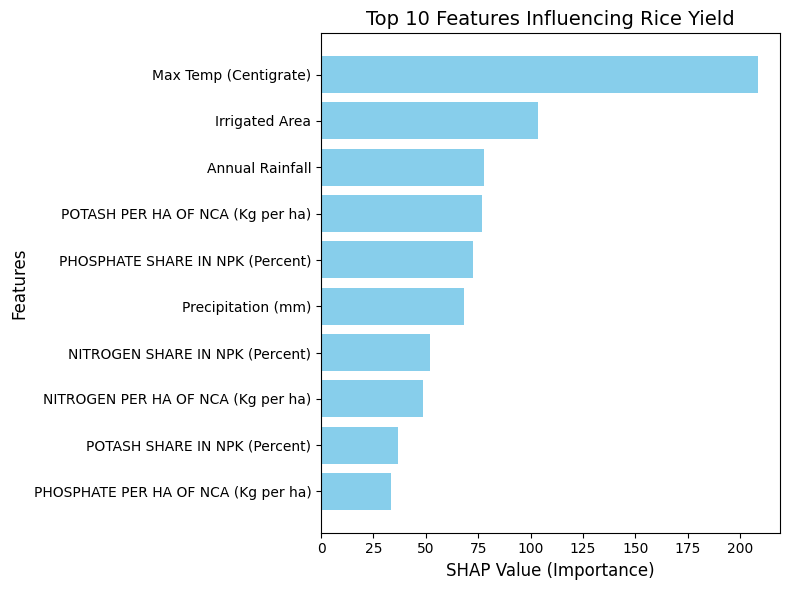

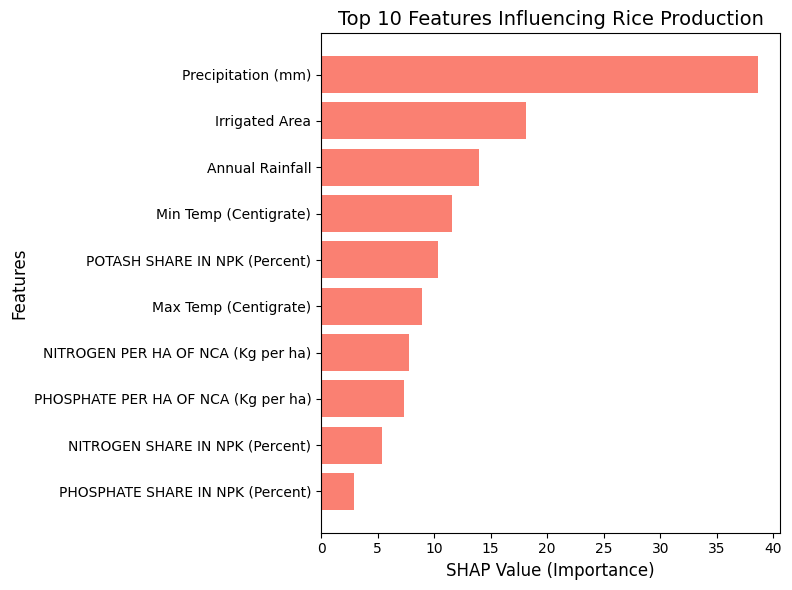

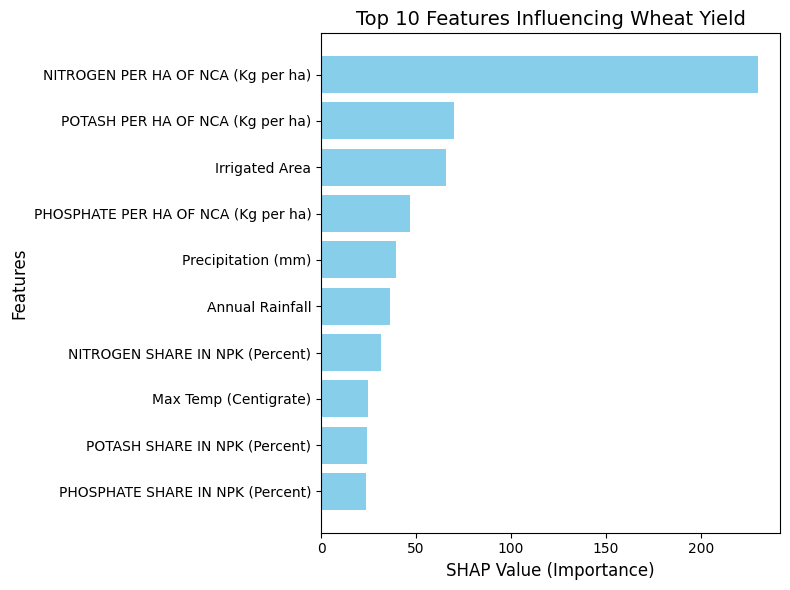

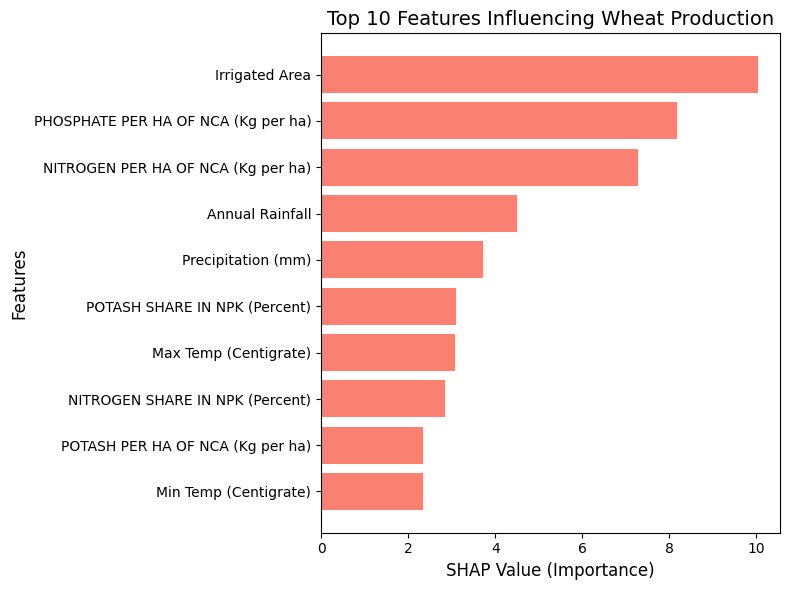

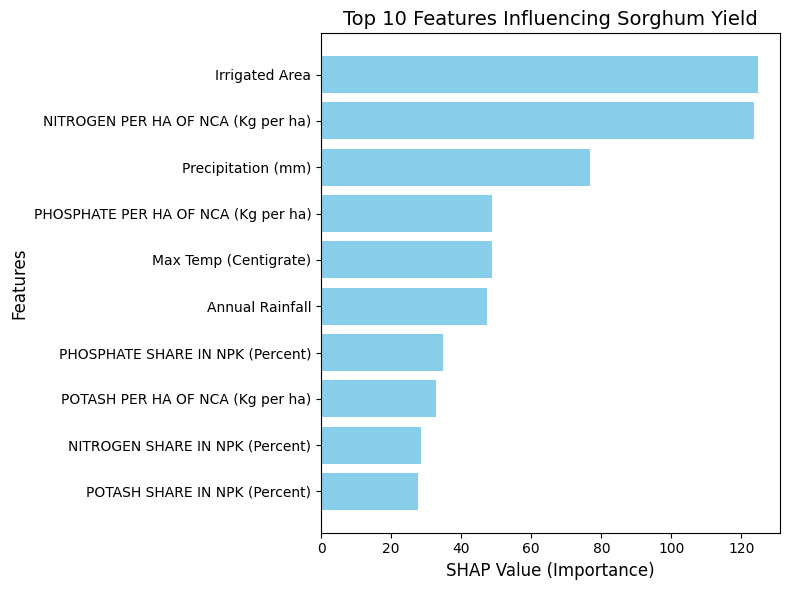

...

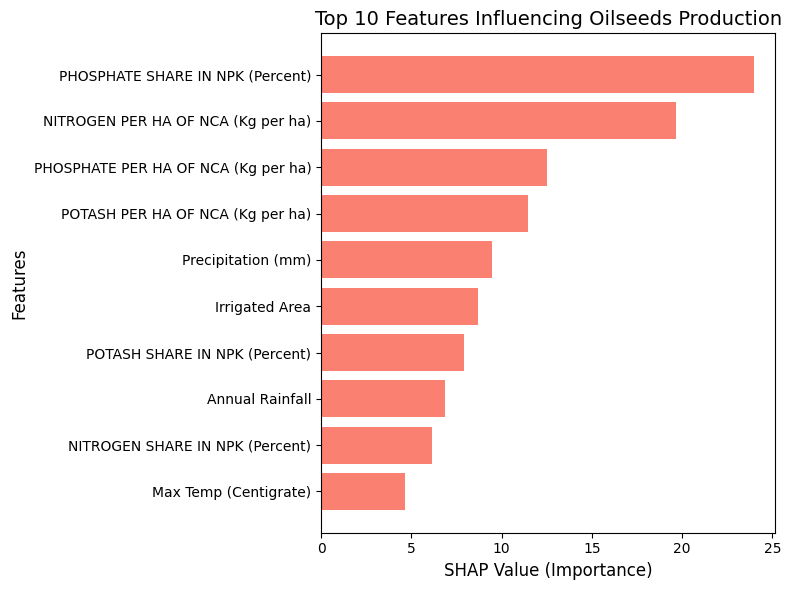

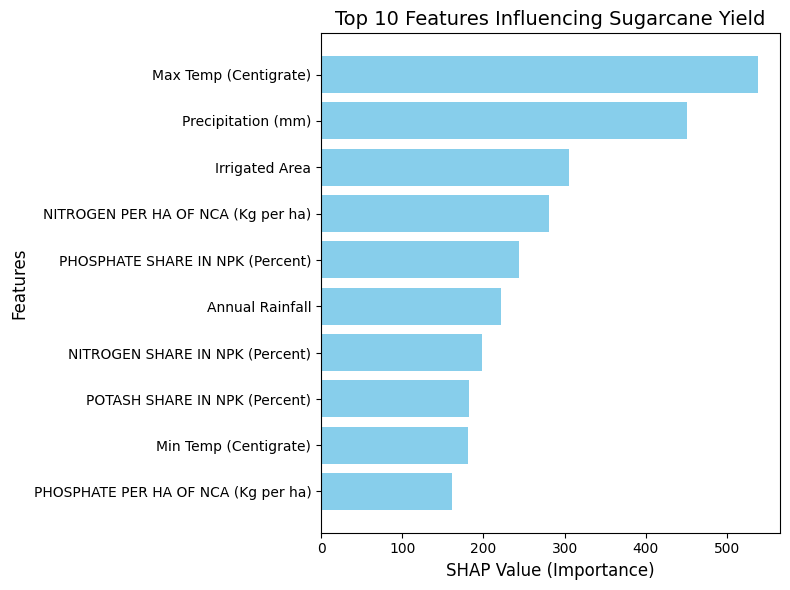

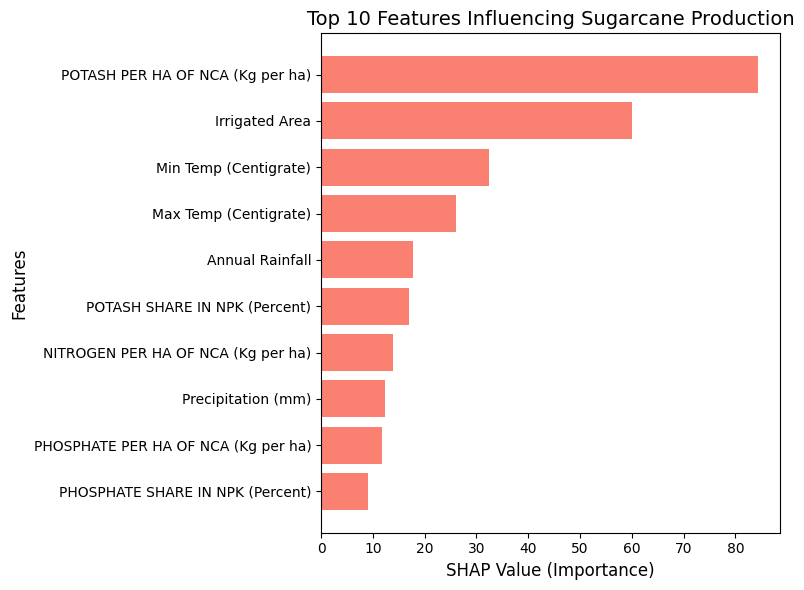

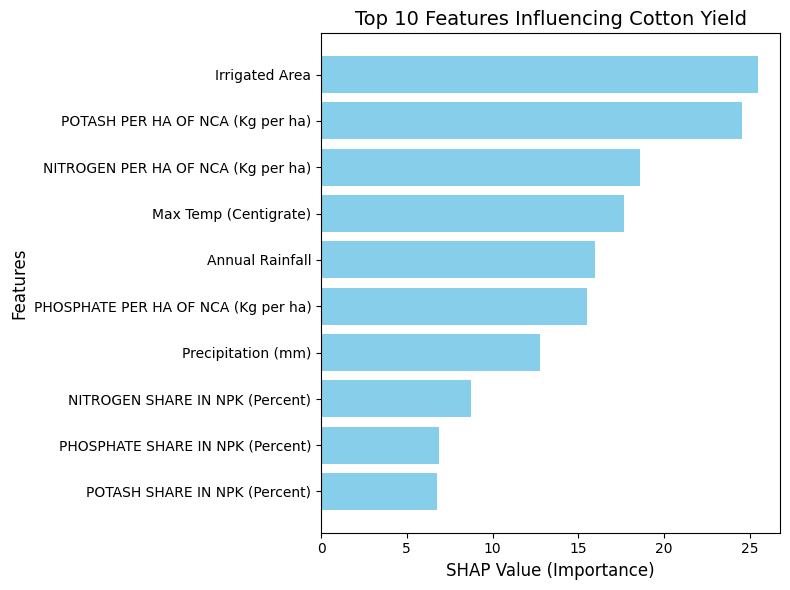

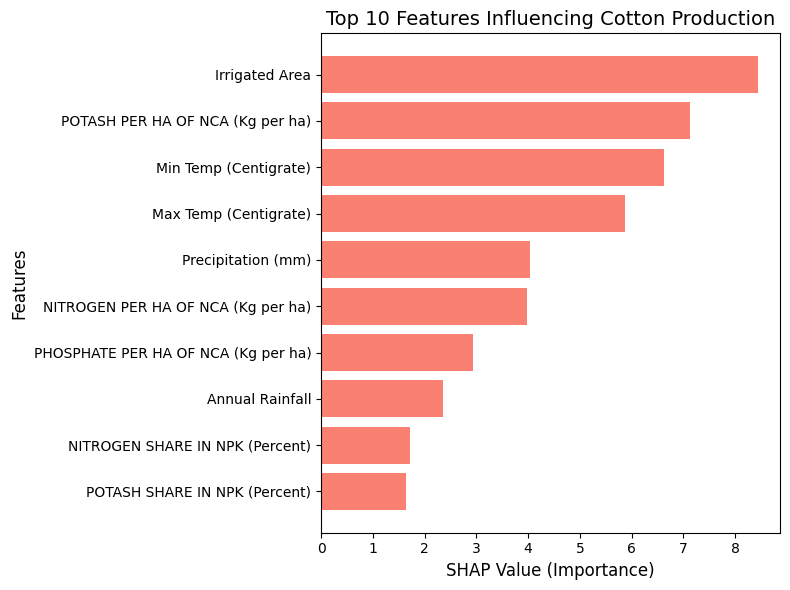

In [ ]:
import pandas as pd
import shap
import matplotlib.pyplot as plt
import xgboost as xgb

# Load dataset
file_path = "/content/Crop_Data_Final.csv"
df = pd.read_csv(file_path)

# Define crop columns
crop_columns = {
    'Rice': ['RICE AREA (1000 ha)', 'RICE PRODUCTION (1000 tons)', 'RICE YIELD (Kg per ha)'],
    'Wheat': ['WHEAT AREA (1000 ha)', 'WHEAT PRODUCTION (1000 tons)', 'WHEAT YIELD (Kg per ha)'],
    'Sorghum': ['SORGHUM AREA (1000 ha)', 'SORGHUM PRODUCTION (1000 tons)', 'SORGHUM YIELD (Kg per ha)'],
    'Pearl Millet': ['PEARL MILLET AREA (1000 ha)', 'PEARL MILLET PRODUCTION (1000 tons)', 'PEARL MILLET YIELD (Kg per ha)'],
    'Maize': ['MAIZE AREA (1000 ha)', 'MAIZE PRODUCTION (1000 tons)', 'MAIZE YIELD (Kg per ha)'],
    'Chickpea': ['CHICKPEA AREA (1000 ha)', 'CHICKPEA PRODUCTION (1000 tons)', 'CHICKPEA YIELD (Kg per ha)'],
    'Pigeonpea': ['PIGEONPEA AREA (1000 ha)', 'PIGEONPEA PRODUCTION (1000 tons)', 'PIGEONPEA YIELD (Kg per ha)'],
    'Minor Pulses': ['MINOR PULSES AREA (1000 ha)', 'MINOR PULSES PRODUCTION (1000 tons)', 'MINOR PULSES YIELD (Kg per ha)'],
    'Groundnut': ['GROUNDNUT AREA (1000 ha)', 'GROUNDNUT PRODUCTION (1000 tons)', 'GROUNDNUT YIELD (Kg per ha)'],
    'Sesamum': ['SESAMUM AREA (1000 ha)', 'SESAMUM PRODUCTION (1000 tons)', 'SESAMUM YIELD (Kg per ha)'],
    'Oilseeds': ['OILSEEDS AREA (1000 ha)', 'OILSEEDS PRODUCTION (1000 tons)', 'OILSEEDS YIELD (Kg per ha)'],
    'Sugarcane': ['SUGARCANE AREA (1000 ha)', 'SUGARCANE PRODUCTION (1000 tons)', 'SUGARCANE YIELD (Kg per ha)'],
    'Cotton': ['COTTON AREA (1000 ha)', 'COTTON PRODUCTION (1000 tons)', 'COTTON YIELD (Kg per ha)'],
}

# Additional attributes
other_attributes = [
    'NITROGEN SHARE IN NPK (Percent)', 'PHOSPHATE SHARE IN NPK (Percent)', 'POTASH SHARE IN NPK (Percent)',
    'NITROGEN PER HA OF NCA (Kg per ha)', 'PHOSPHATE PER HA OF NCA (Kg per ha)', 'POTASH PER HA OF NCA (Kg per ha)',
    'Min Temp (Centigrate)', 'Max Temp (Centigrate)', 'Precipitation (mm)', 'Irrigated Area', 'Annual Rainfall'
]

# Iterate through each crop for SHAP analysis
for crop, columns in crop_columns.items():
    area_col, production_col, yield_col = columns

    # Define features and targets
    features = df[other_attributes]
    y_yield = df[yield_col]
    y_production = df[production_col]

    # Train XGBoost models
    model_yield = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, random_state=42)
    model_production = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, random_state=42)

    model_yield.fit(features, y_yield)
    model_production.fit(features, y_production)

    # SHAP explanations
    explainer_yield = shap.Explainer(model_yield, features)
    explainer_production = shap.Explainer(model_production, features)

    shap_values_yield = explainer_yield(features)
    shap_values_production = explainer_production(features)

    # Calculate SHAP values
    importance_yield = pd.DataFrame({
        'Feature': features.columns,
        'Importance': shap_values_yield.abs.mean(0).values
    }).sort_values(by='Importance', ascending=False).head(10)

    importance_production = pd.DataFrame({
        'Feature': features.columns,
        'Importance': shap_values_production.abs.mean(0).values
    }).sort_values(by='Importance', ascending=False).head(10)

    # Plot for Yield
    plt.figure(figsize=(8, 6))  # Adjusted figure size
    plt.barh(importance_yield['Feature'], importance_yield['Importance'], color='skyblue')
    plt.gca().invert_yaxis()
    plt.title(f'Top 10 Features Influencing {crop} Yield', fontsize=14)
    plt.xlabel('SHAP Value (Importance)', fontsize=12)
    plt.ylabel('Features', fontsize=12)
    plt.tight_layout()  # Ensures proper spacing
    plt.show()

    # Plot for Production
    plt.figure(figsize=(8, 6))  # Adjusted figure size
    plt.barh(importance_production['Feature'], importance_production['Importance'], color='salmon')
    plt.gca().invert_yaxis()
    plt.title(f'Top 10 Features Influencing {crop} Production', fontsize=14)
    plt.xlabel('SHAP Value (Importance)', fontsize=12)
    plt.ylabel('Features', fontsize=12)
    plt.tight_layout()  # Ensures proper spacing
    plt.show()

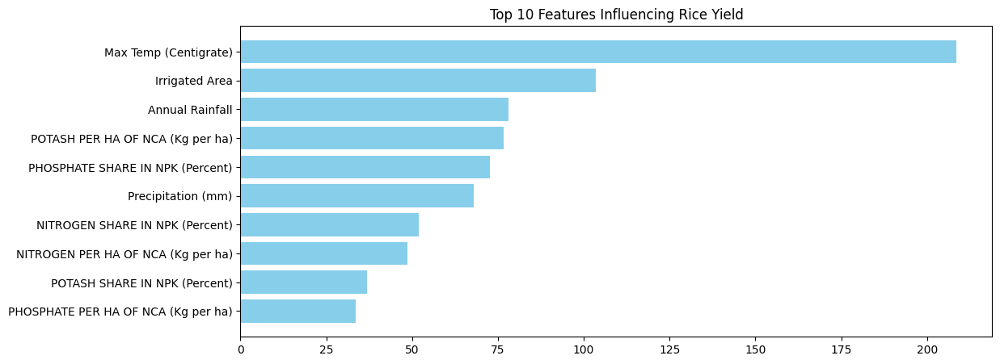

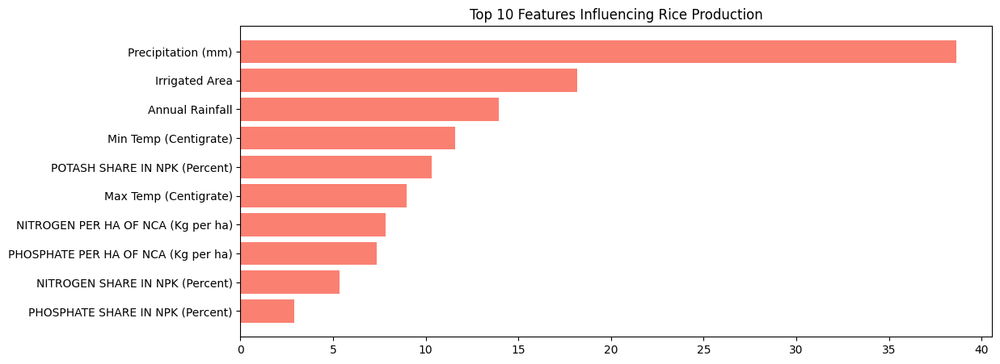

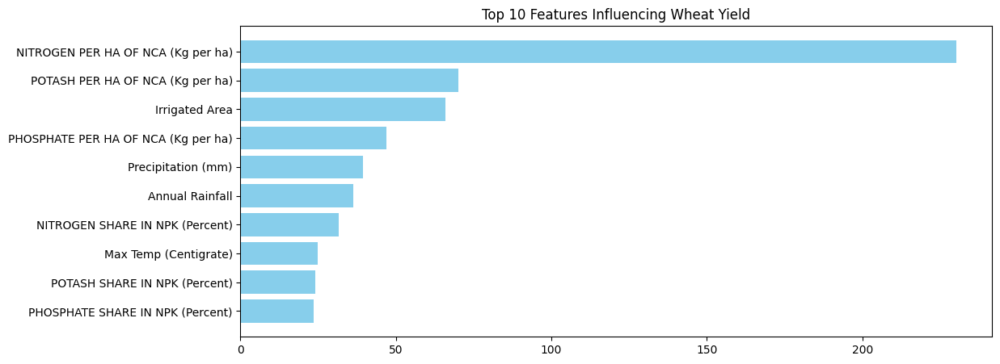

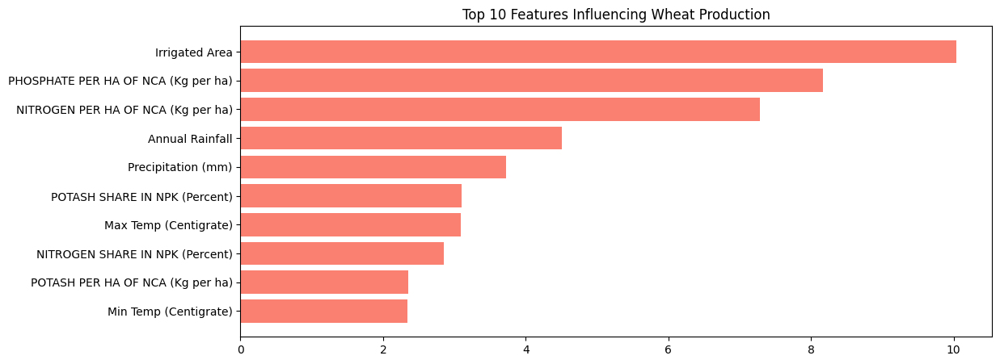

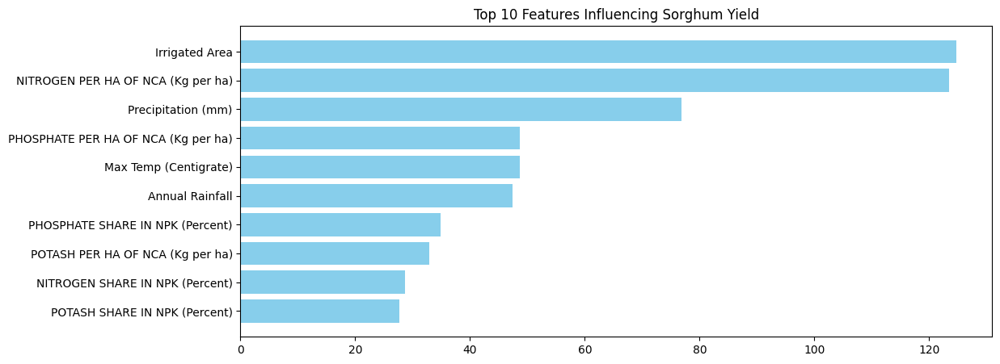

...

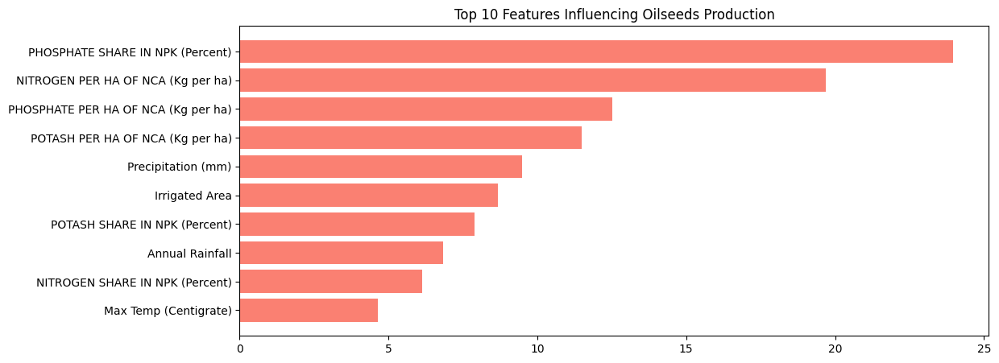

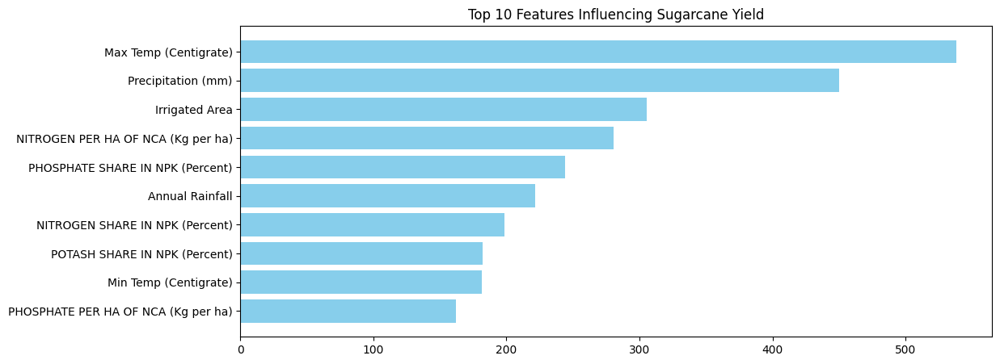

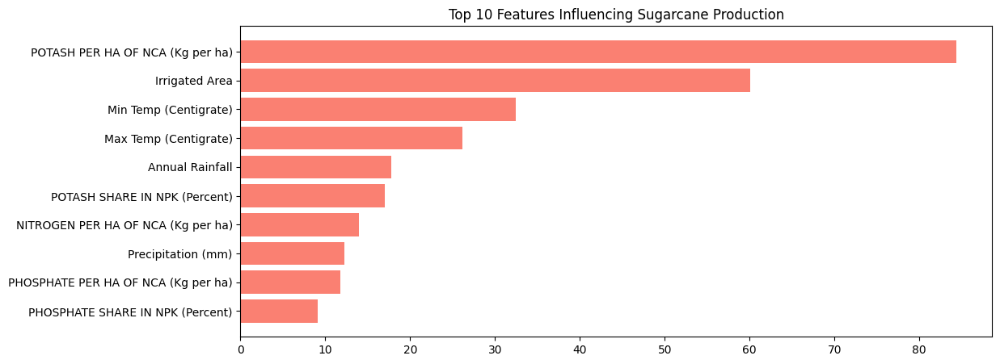

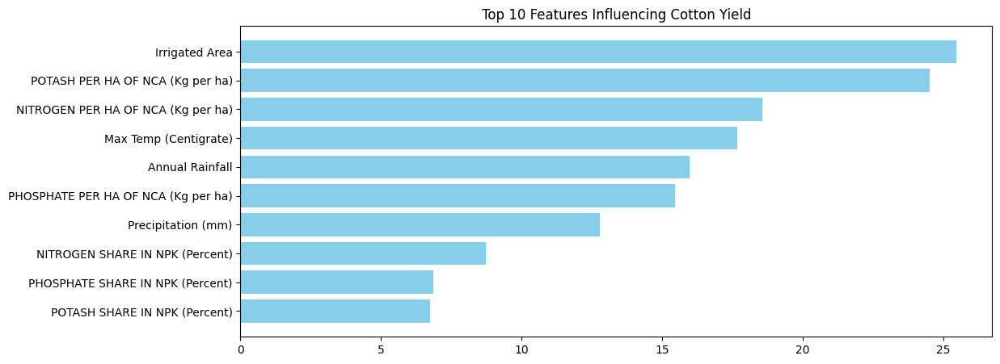

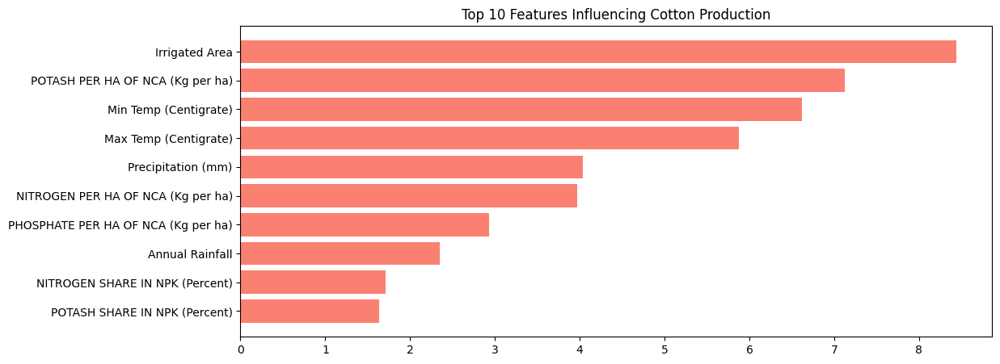

In [ ]:
import pandas as pd
import shap
import matplotlib.pyplot as plt
import xgboost as xgb

# Load dataset
file_path = "/content/Crop_Data_Final.csv"
df = pd.read_csv(file_path)

# Define crop columns
crop_columns = {
    'Rice': ['RICE AREA (1000 ha)', 'RICE PRODUCTION (1000 tons)', 'RICE YIELD (Kg per ha)'],
    'Wheat': ['WHEAT AREA (1000 ha)', 'WHEAT PRODUCTION (1000 tons)', 'WHEAT YIELD (Kg per ha)'],
    'Sorghum': ['SORGHUM AREA (1000 ha)', 'SORGHUM PRODUCTION (1000 tons)', 'SORGHUM YIELD (Kg per ha)'],
    'Pearl Millet': ['PEARL MILLET AREA (1000 ha)', 'PEARL MILLET PRODUCTION (1000 tons)', 'PEARL MILLET YIELD (Kg per ha)'],
    'Maize': ['MAIZE AREA (1000 ha)', 'MAIZE PRODUCTION (1000 tons)', 'MAIZE YIELD (Kg per ha)'],
    'Chickpea': ['CHICKPEA AREA (1000 ha)', 'CHICKPEA PRODUCTION (1000 tons)', 'CHICKPEA YIELD (Kg per ha)'],
    'Pigeonpea': ['PIGEONPEA AREA (1000 ha)', 'PIGEONPEA PRODUCTION (1000 tons)', 'PIGEONPEA YIELD (Kg per ha)'],
    'Minor Pulses': ['MINOR PULSES AREA (1000 ha)', 'MINOR PULSES PRODUCTION (1000 tons)', 'MINOR PULSES YIELD (Kg per ha)'],
    'Groundnut': ['GROUNDNUT AREA (1000 ha)', 'GROUNDNUT PRODUCTION (1000 tons)', 'GROUNDNUT YIELD (Kg per ha)'],
    'Sesamum': ['SESAMUM AREA (1000 ha)', 'SESAMUM PRODUCTION (1000 tons)', 'SESAMUM YIELD (Kg per ha)'],
    'Oilseeds': ['OILSEEDS AREA (1000 ha)', 'OILSEEDS PRODUCTION (1000 tons)', 'OILSEEDS YIELD (Kg per ha)'],
    'Sugarcane': ['SUGARCANE AREA (1000 ha)', 'SUGARCANE PRODUCTION (1000 tons)', 'SUGARCANE YIELD (Kg per ha)'],
    'Cotton': ['COTTON AREA (1000 ha)', 'COTTON PRODUCTION (1000 tons)', 'COTTON YIELD (Kg per ha)'],
}

# Additional attributes
other_attributes = [
    'NITROGEN SHARE IN NPK (Percent)', 'PHOSPHATE SHARE IN NPK (Percent)', 'POTASH SHARE IN NPK (Percent)',
    'NITROGEN PER HA OF NCA (Kg per ha)', 'PHOSPHATE PER HA OF NCA (Kg per ha)', 'POTASH PER HA OF NCA (Kg per ha)',
    'Min Temp (Centigrate)', 'Max Temp (Centigrate)', 'Precipitation (mm)', 'Irrigated Area', 'Annual Rainfall'
]

# Iterate through each crop for SHAP analysis
for crop, columns in crop_columns.items():
    area_col, production_col, yield_col = columns

    # Define features and targets
    features = df[other_attributes]
    y_yield = df[yield_col]
    y_production = df[production_col]

    # Train XGBoost models
    model_yield = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, random_state=42)
    model_production = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, random_state=42)

    model_yield.fit(features, y_yield)
    model_production.fit(features, y_production)

    # SHAP explanations
    explainer_yield = shap.Explainer(model_yield, features)
    explainer_production = shap.Explainer(model_production, features)

    shap_values_yield = explainer_yield(features)
    shap_values_production = explainer_production(features)

    # Calculate SHAP values
    importance_yield = pd.DataFrame({
        'Feature': features.columns,
        'Importance': shap_values_yield.abs.mean(0).values
    }).sort_values(by='Importance', ascending=False).head(10)

    importance_production = pd.DataFrame({
        'Feature': features.columns,
        'Importance': shap_values_production.abs.mean(0).values
    }).sort_values(by='Importance', ascending=False).head(10)

    # Plot for Yield
    plt.figure(figsize=(12, 5))
    plt.barh(importance_yield['Feature'], importance_yield['Importance'], color='skyblue')
    plt.gca().invert_yaxis()
    plt.title(f'Top 10 Features Influencing {crop} Yield')
    plt.show()

    # Plot for Production
    plt.figure(figsize=(12, 5))
    plt.barh(importance_production['Feature'], importance_production['Importance'], color='salmon')
    plt.gca().invert_yaxis()
    plt.title(f'Top 10 Features Influencing {crop} Production')
    plt.show()


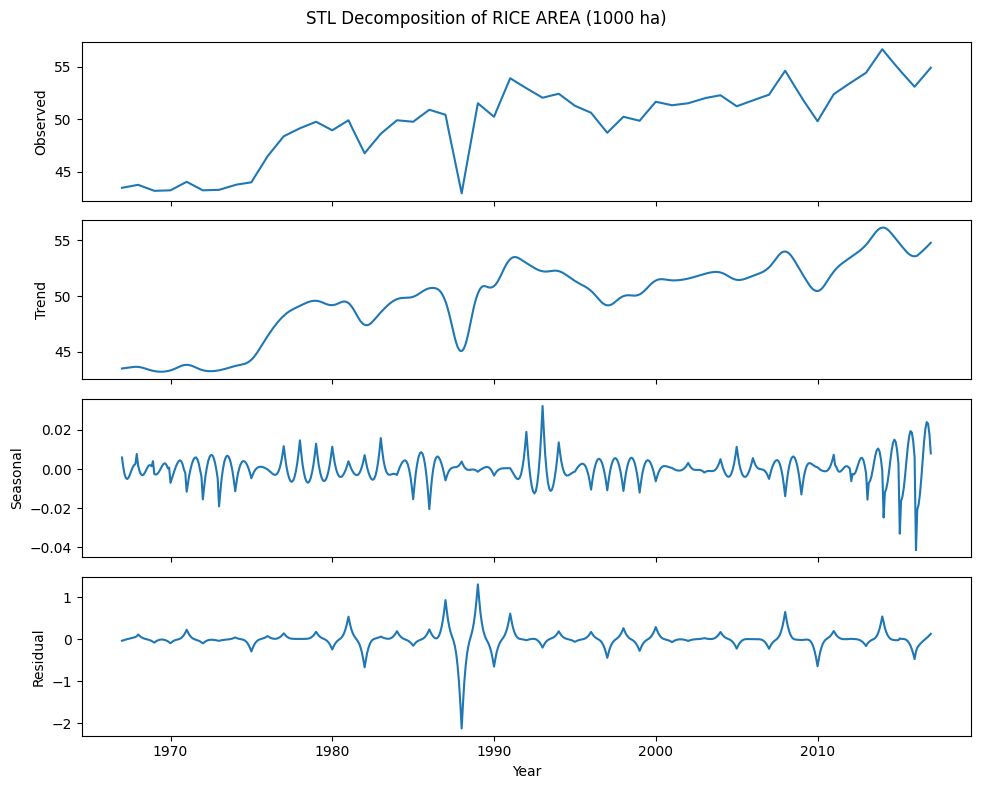

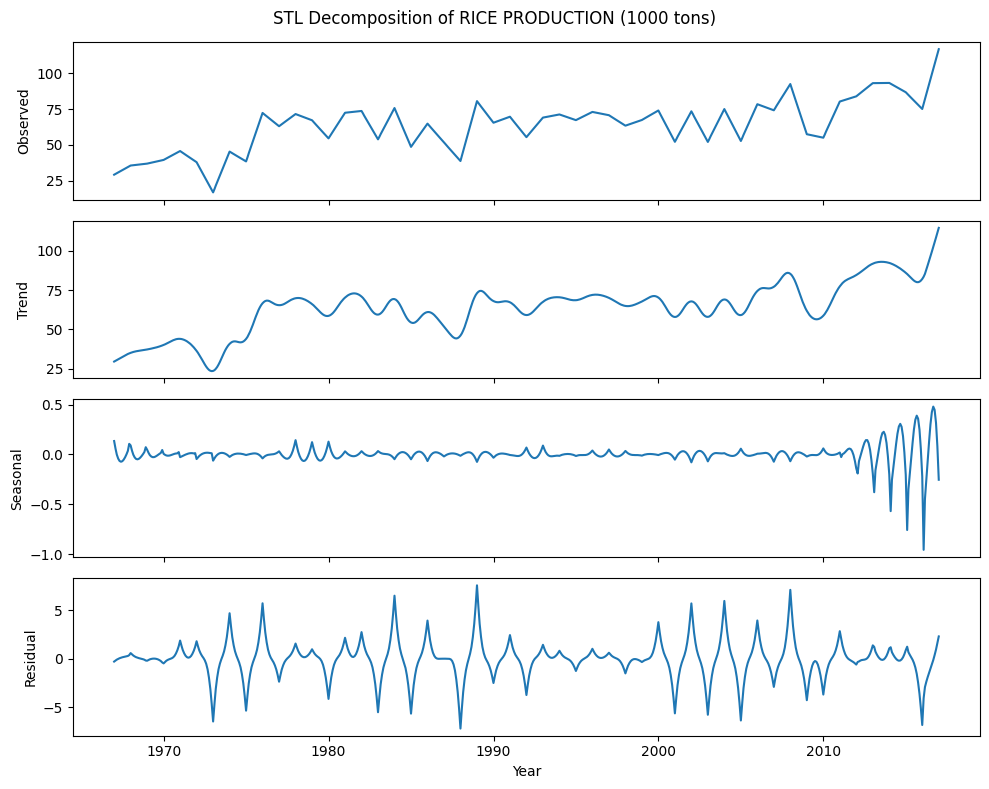

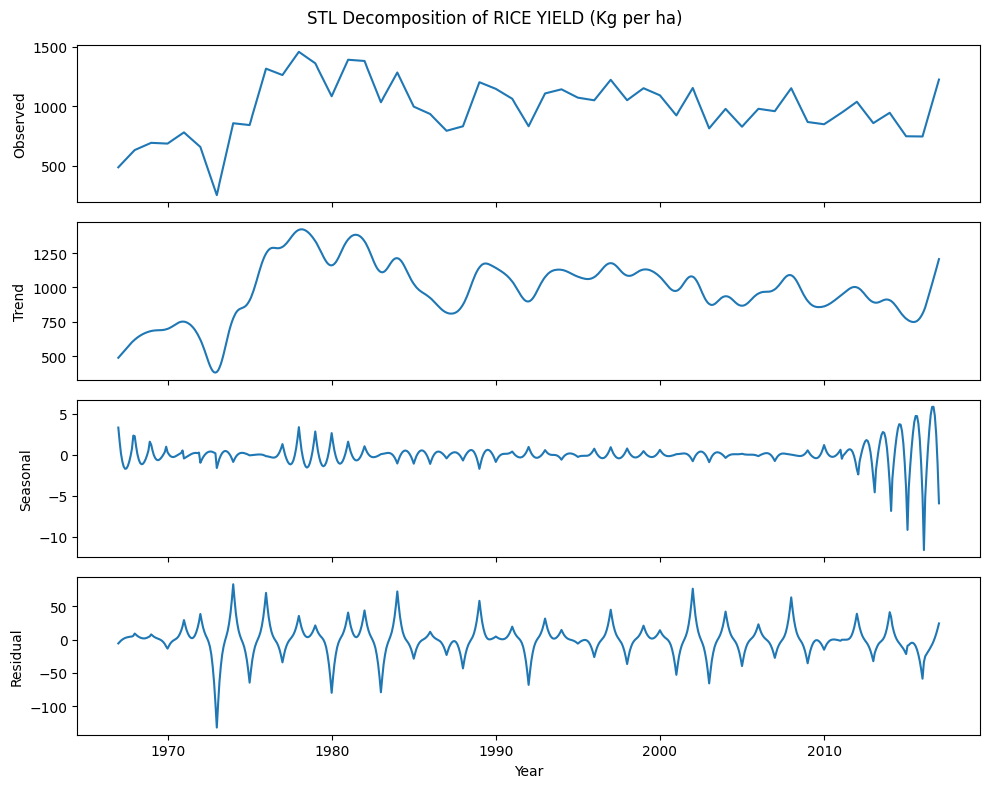

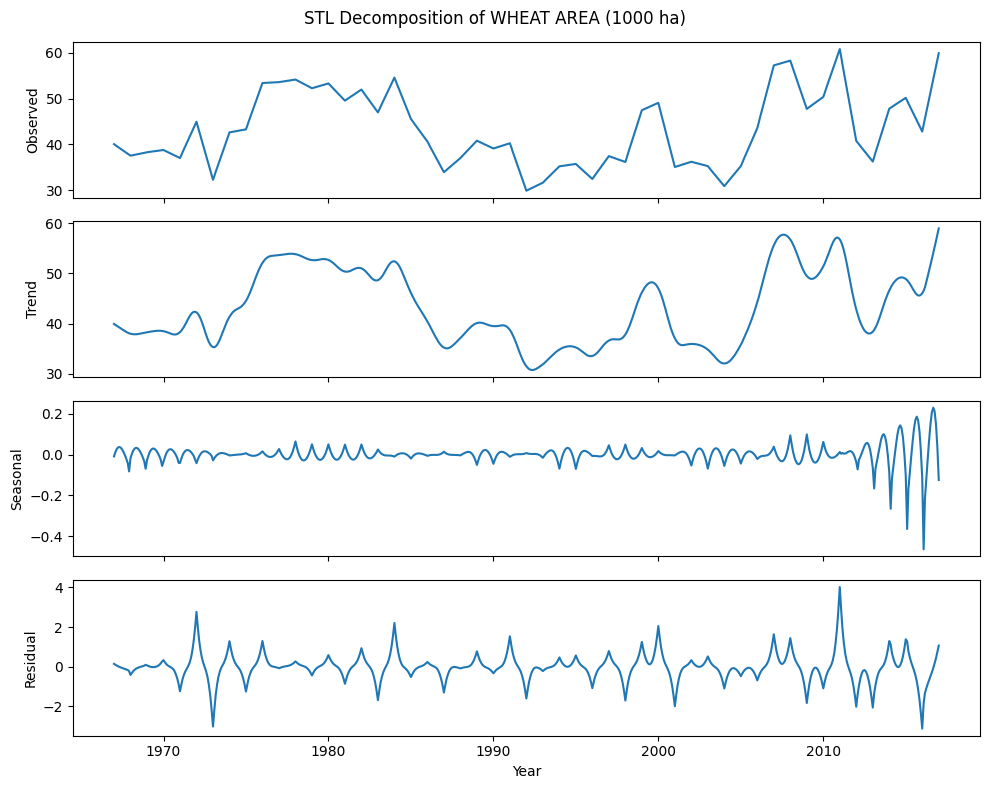

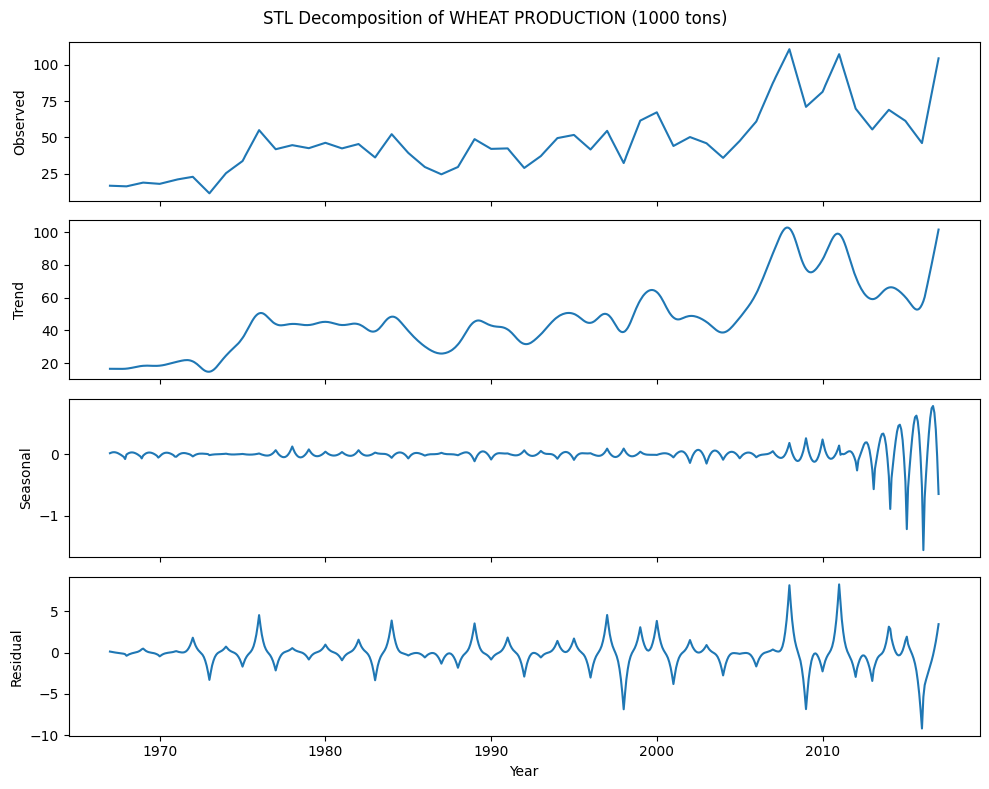

...

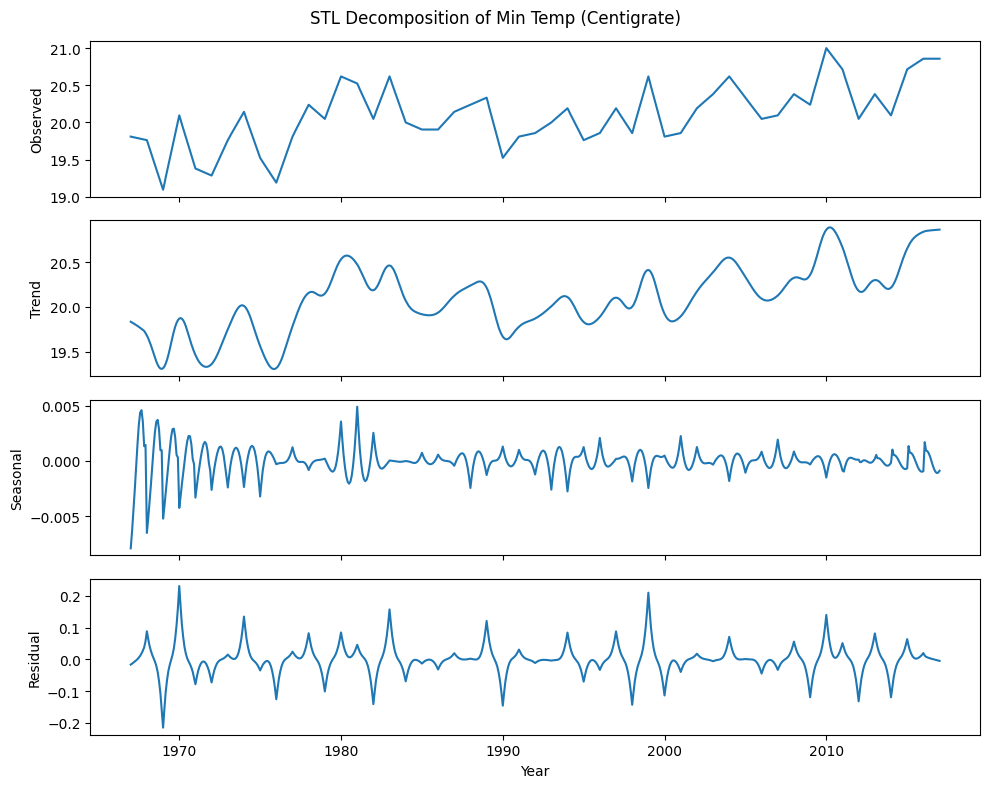

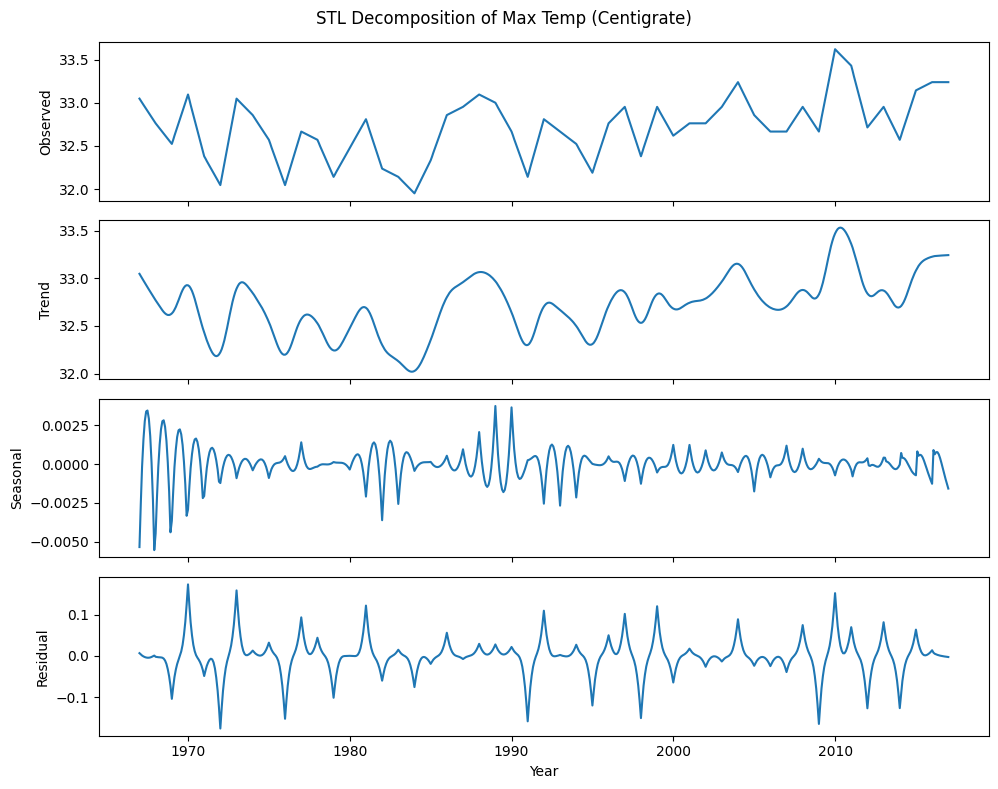

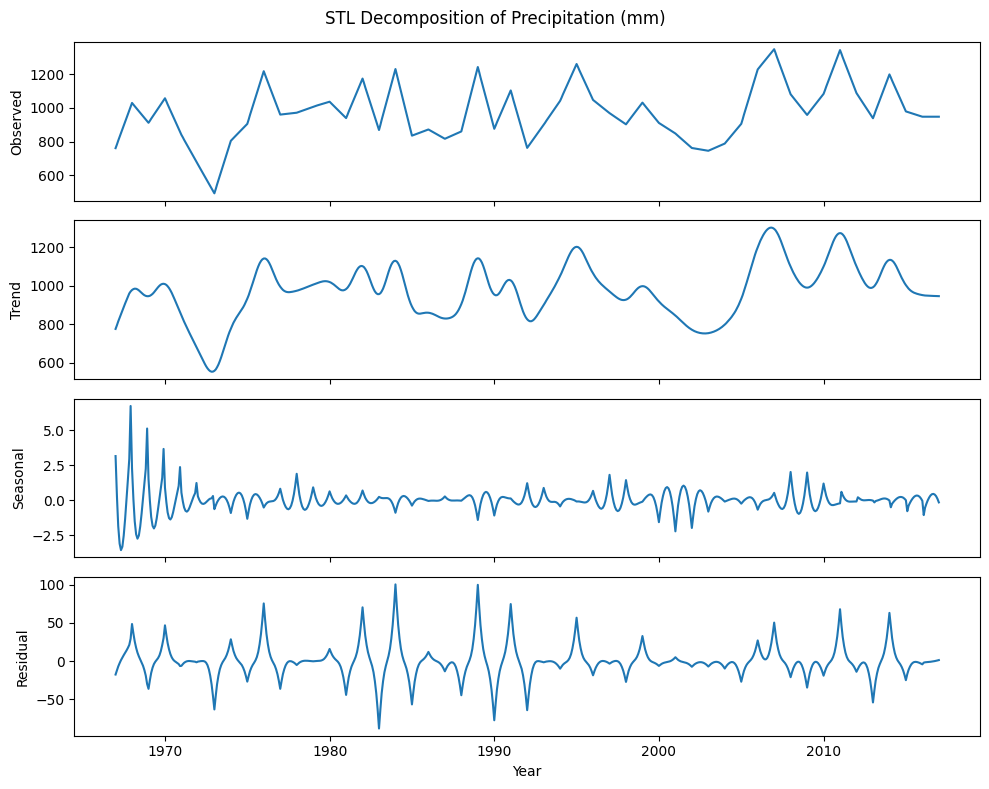

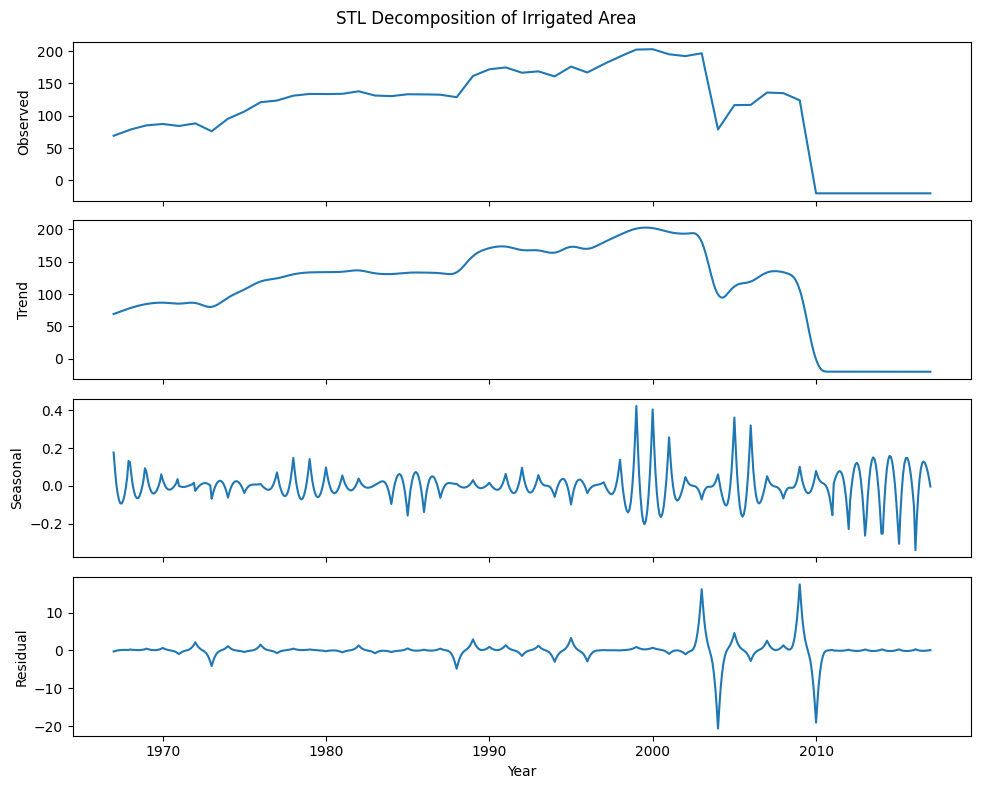

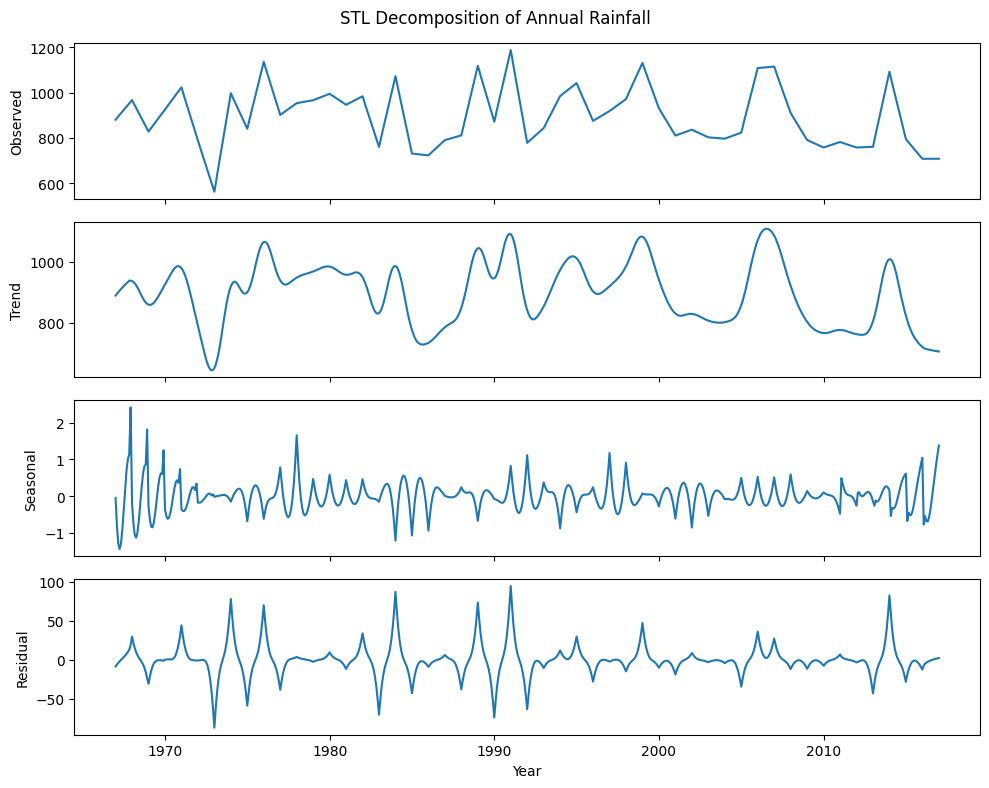

In [ ]:
import pandas as pd
from statsmodels.tsa.seasonal import STL
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/content/Crop_Data_Final.csv'  # Adjust if needed
data = pd.read_csv(file_path)

# Convert 'Year' to datetime format and set as the index
data['Year'] = pd.to_datetime(data['Year'], format='%Y')
data.set_index('Year', inplace=True)

# Select only numeric columns for STL decomposition
numeric_columns = data.select_dtypes(include=['number']).columns

# Iterate through each numeric column to apply STL decomposition
for column in numeric_columns:
    # Resample yearly data to monthly frequency using interpolation
    yearly_data = data[column].resample('YE').mean()  # Adjust aggregation method if needed
    monthly_data = yearly_data.resample('ME').interpolate()

    # Apply STL decomposition
    stl = STL(monthly_data, seasonal=13)
    result = stl.fit()

    # Plot the decomposition
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(10, 8), sharex=True)
    ax1.plot(result.observed, label='Observed')
    ax1.set_ylabel('Observed')
    ax2.plot(result.trend, label='Trend')
    ax2.set_ylabel('Trend')
    ax3.plot(result.seasonal, label='Seasonal')
    ax3.set_ylabel('Seasonal')
    ax4.plot(result.resid, label='Residual')
    ax4.set_ylabel('Residual')
    ax4.set_xlabel('Year')
    plt.suptitle(f'STL Decomposition of {column}')
    plt.tight_layout()
    plt.show()


# GBR BEST DATA

In [ ]:
#https://drive.google.com/file/d/1VeK85HwRdSnqMHP3r5A4Pn3qTyWeqQ5H/view?usp=sharing
import gdown
file_id = '1VeK85HwRdSnqMHP3r5A4Pn3qTyWeqQ5H'
url = f'https://drive.google.com/uc?id={file_id}'
output = 'GBR_Crop_final.csv'
gdown.download(url, output, quiet=False)



#https://drive.google.com/file/d/1RPg2i7ZMfiLesZ7ZahqNg2x_L8qeZkm1/view?usp=sharing
import gdown
file_id = '1RPg2i7ZMfiLesZ7ZahqNg2x_L8qeZkm1'
url = f'https://drive.google.com/uc?id={file_id}'
output = '18Jan_GBRforecasted_future_values.csv'
gdown.download(url, output, quiet=False)

Downloading...
From: https://drive.google.com/uc?id=1VeK85HwRdSnqMHP3r5A4Pn3qTyWeqQ5H
To: /content/GBR_Crop_final.csv
100%|██████████| 1.02M/1.02M [00:00<00:00, 11.0MB/s]
Downloading...
From: https://drive.google.com/uc?id=1RPg2i7ZMfiLesZ7ZahqNg2x_L8qeZkm1
To: /content/18Jan_GBRforecasted_future_values.csv
100%|██████████| 466k/466k [00:00<00:00, 6.57MB/s]


'18Jan_GBRforecasted_future_values.csv'

##Aggregate STL on forecasted data

In [ ]:
import pandas as pd
df_agg = pd.read_csv('18Jan_GBRforecasted_future_values.csv')

In [ ]:
df_agg

,District,Year,Target Column,Forecasted Value
0,Ahmednagar,2018,Area,2307.139029
1,Ahmednagar,2019,Area,2371.635693
2,Ahmednagar,2020,Area,1912.812877
3,Ahmednagar,2021,Area,1850.526175
4,Ahmednagar,2022,Area,1913.346422
...,...,...,...,...
7915,Yeotmal,2025,Evapotranspiration (mm),736.246241
7916,Yeotmal,2030,Evapotranspiration (mm),751.406724
7917,Yeotmal,2035,Evapotranspiration (mm),824.856876
7918,Yeotmal,2040,Evapotranspiration (mm),712.631474


In [ ]:
import pandas as pd

# Assuming your dataframe is named df
# Pivot the dataframe to spread each target into its own column
pivoted_df = df_agg.pivot_table(index=['District', 'Year'], columns='Target Column', values='Forecasted Value')

# Flatten the columns to make them more readable (Optional)
pivoted_df.columns = [col for col in pivoted_df.columns]

# Reset the index to make 'District' and 'Year' regular columns again
pivoted_df = pivoted_df.reset_index()

# Display the reshaped dataframe
print(pivoted_df)


       District  Year  Annual Rainfall         Area  \
0    Ahmednagar  2018       532.656513  2307.139029   
1    Ahmednagar  2019       575.430832  2371.635693   
2    Ahmednagar  2020       501.317025  1912.812877   
3    Ahmednagar  2021       636.162228  1850.526175   
4    Ahmednagar  2022       497.676125  1913.346422   
..          ...   ...              ...          ...   
235     Yeotmal  2025       974.992532  1199.853132   
236     Yeotmal  2030       986.200943  1166.338234   
237     Yeotmal  2035      1052.512189  1193.085381   
238     Yeotmal  2040       985.406695  1218.096436   
239     Yeotmal  2045       973.136153  1218.096436   

     BARREN AND UNCULTIVABLE LAND AREA (1000 ha)  CROPING INTENSITY (Percent)  \
0                                     156.999933                   107.027314   
1                                     155.400014                   105.385924   
2                                     149.800105                   104.836447   
3              

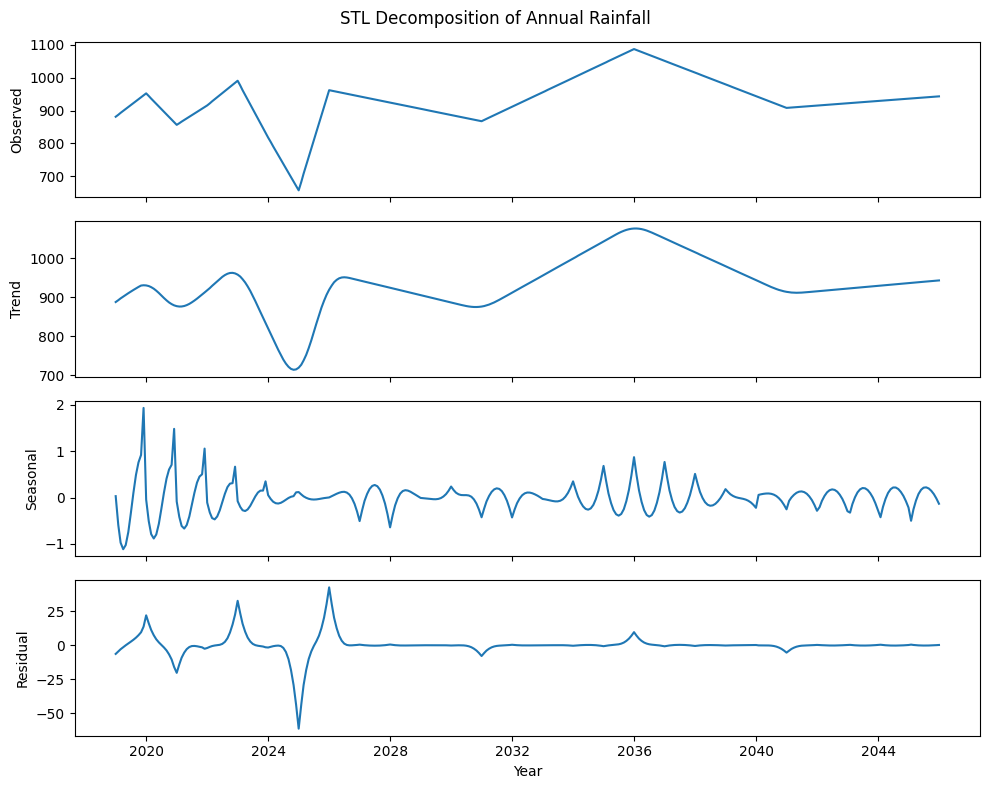

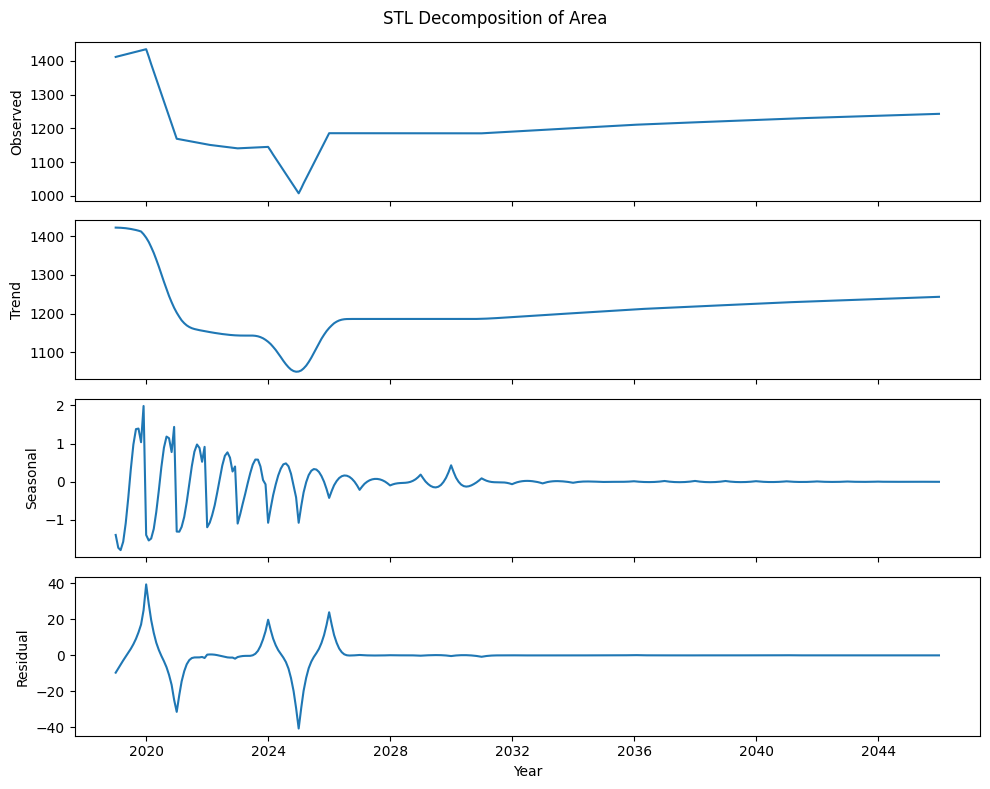

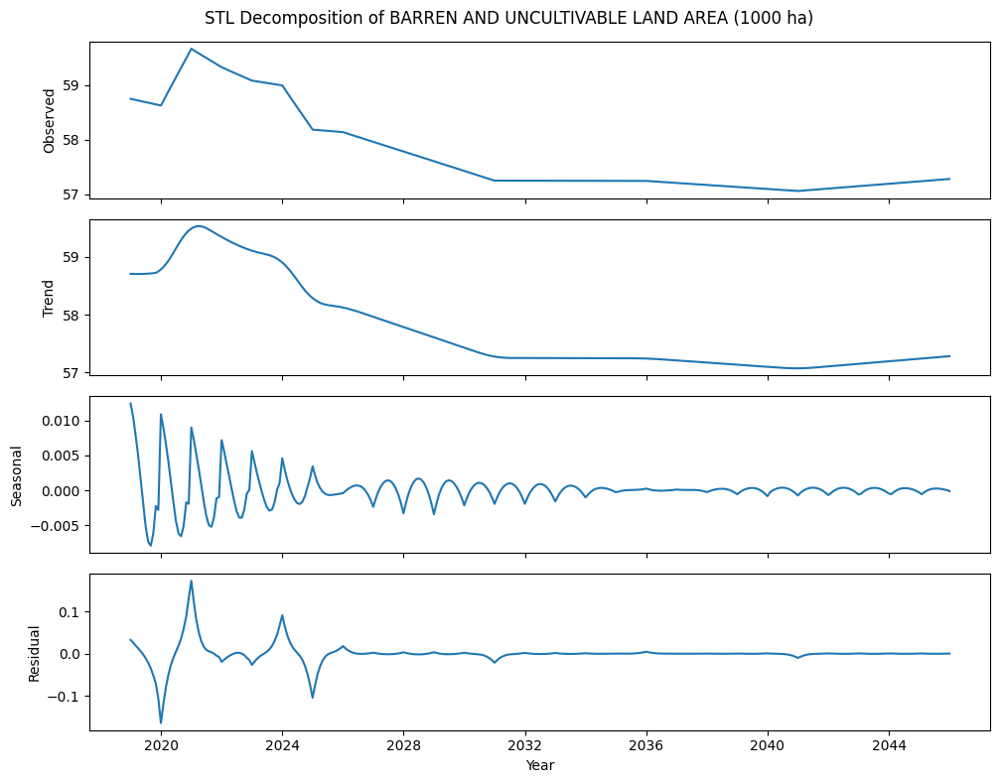

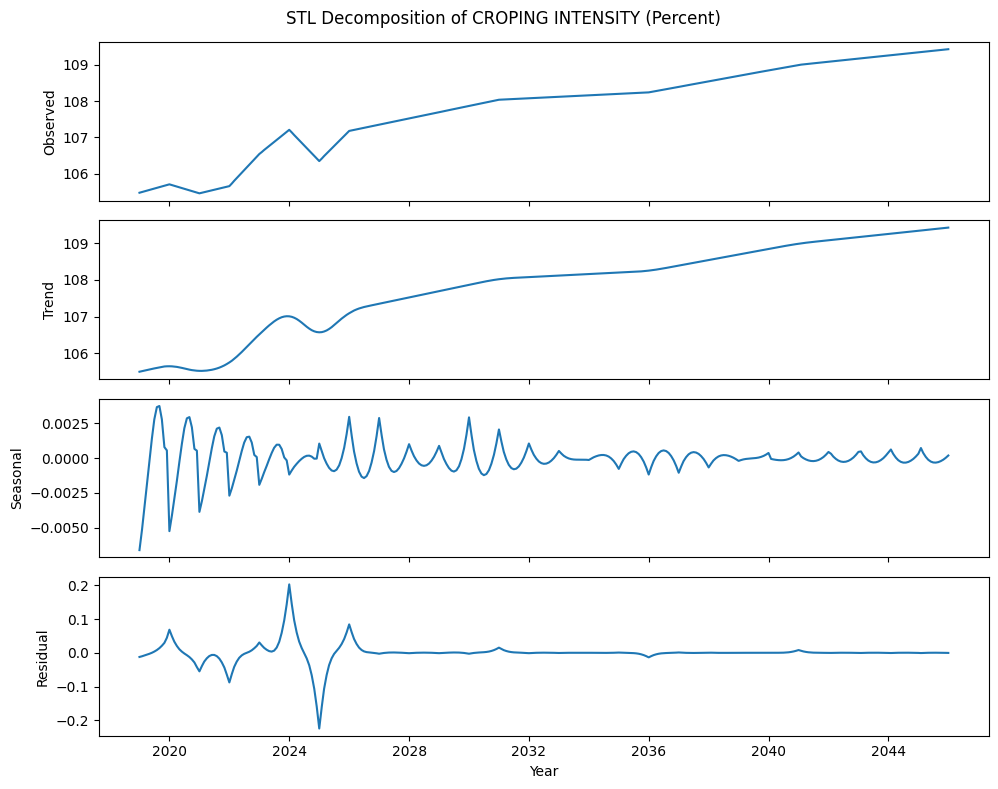

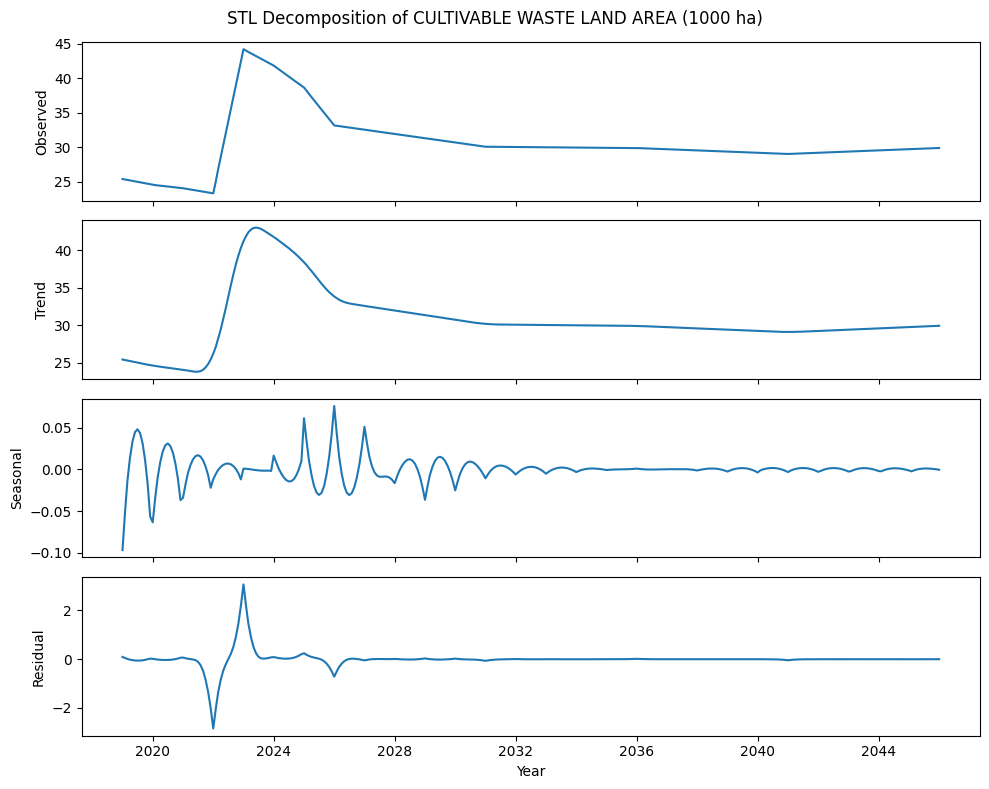

...

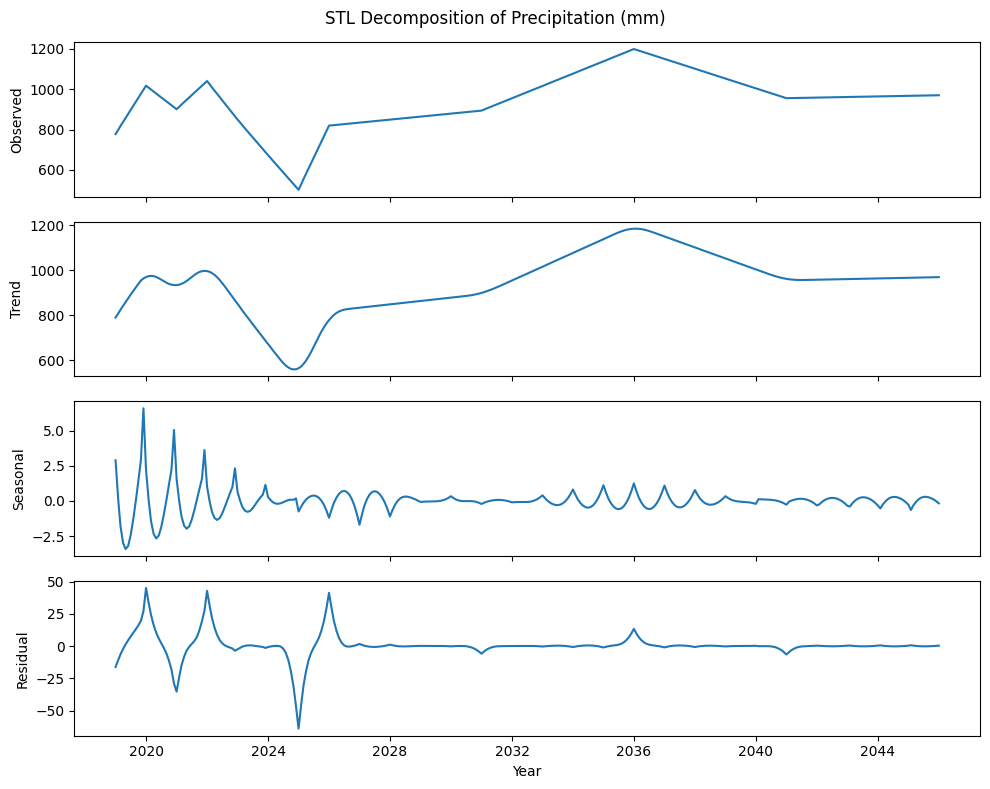

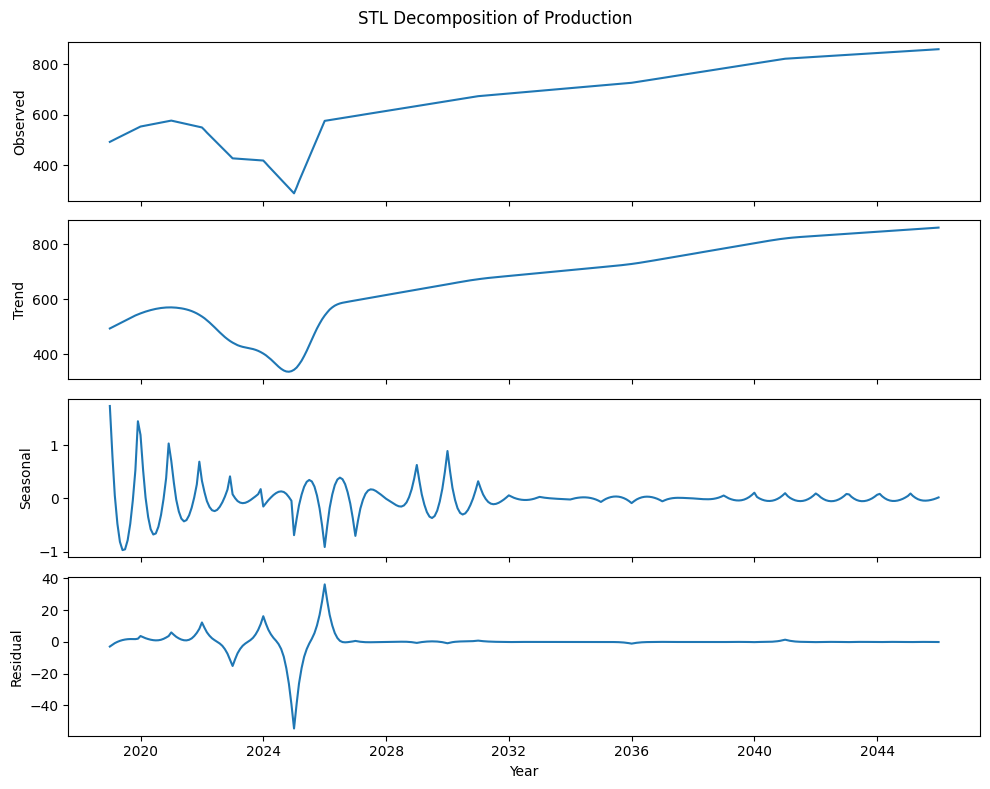

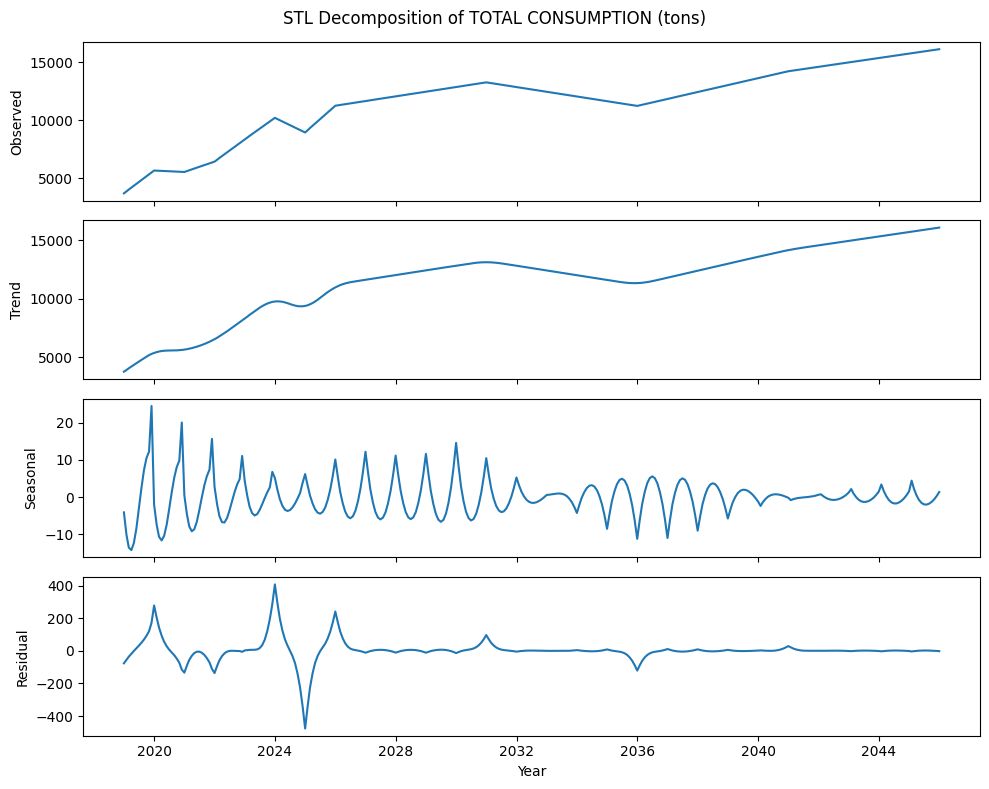

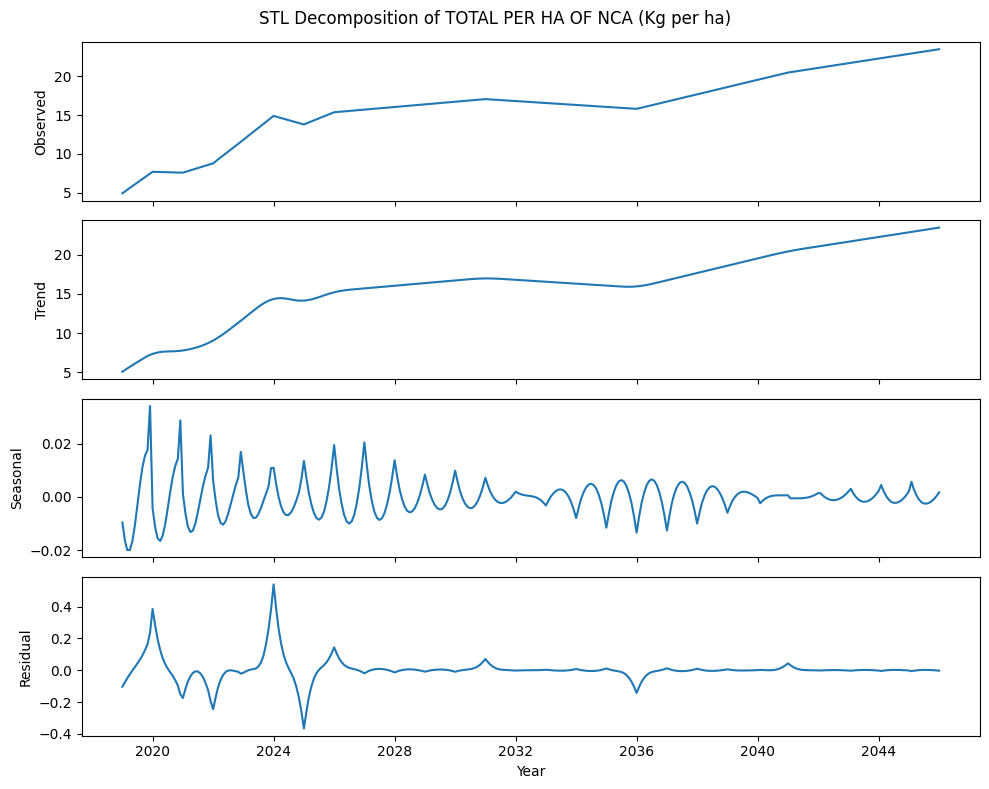

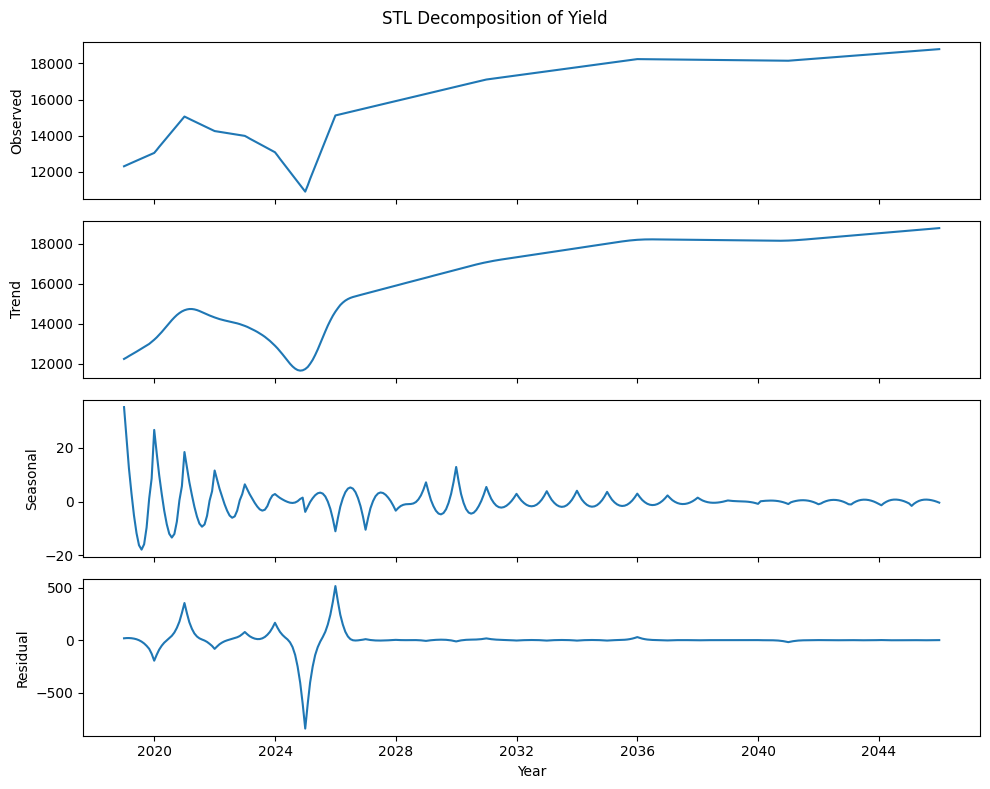

In [ ]:
import pandas as pd
from statsmodels.tsa.seasonal import STL
import matplotlib.pyplot as plt

data = pivoted_df.copy()

# Convert 'Year' to datetime format and set as the index
data['Year'] = pd.to_datetime(data['Year'], format='%Y')
data.set_index('Year', inplace=True)

# Select only numeric columns for STL decomposition
numeric_columns = data.select_dtypes(include=['number']).columns

# Iterate through each numeric column to apply STL decomposition
for column in numeric_columns:
    # Resample yearly data to monthly frequency using interpolation
    yearly_data = data[column].resample('YE').mean()  # Adjust aggregation method if needed
    monthly_data = yearly_data.resample('ME').interpolate()

    # Apply STL decomposition
    stl = STL(monthly_data, seasonal=13)
    result = stl.fit()

    # Plot the decomposition
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(10, 8), sharex=True)
    ax1.plot(result.observed, label='Observed')
    ax1.set_ylabel('Observed')
    ax2.plot(result.trend, label='Trend')
    ax2.set_ylabel('Trend')
    ax3.plot(result.seasonal, label='Seasonal')
    ax3.set_ylabel('Seasonal')
    ax4.plot(result.resid, label='Residual')
    ax4.set_ylabel('Residual')
    ax4.set_xlabel('Year')
    plt.suptitle(f'STL Decomposition of {column}')
    plt.tight_layout()
    plt.show()

##Crop STL on forecasted data

In [ ]:
import pandas as pd
df_crop = pd.read_csv('GBR_Crop_final.csv')

In [ ]:
import pandas as pd

# Assuming your dataframe is named df
# Pivot the dataframe to spread each target into its own column
pivoted_df = df_crop.pivot_table(index=['District', 'Year'], columns='Target Column', values='Forecasted Value')

# Flatten the columns to make them more readable (Optional)
pivoted_df.columns = [col for col in pivoted_df.columns]

# Reset the index to make 'District' and 'Year' regular columns again
pivoted_df = pivoted_df.reset_index()

# Display the reshaped dataframe
print(pivoted_df)


       District  Year  Annual Rainfall  CHICKPEA AREA (1000 ha)  \
0    Ahmednagar  2017       554.050521                22.000469   
1    Ahmednagar  2018       554.454132                22.001705   
2    Ahmednagar  2019       494.669835                21.005779   
3    Ahmednagar  2020       669.256668                19.911215   
4    Ahmednagar  2021       488.297156                18.006995   
..          ...   ...              ...                      ...   
268     Yeotmal  2030       991.997088                 7.999735   
269     Yeotmal  2035       991.997088                10.999886   
270     Yeotmal  2040       991.997088                 6.006140   
271     Yeotmal  2045       991.997088                 7.002410   
272     Yeotmal  2050       991.997088                 7.002410   

     CHICKPEA PRODUCTION (1000 tons)  CHICKPEA YIELD (Kg per ha)  \
0                           7.092822                  318.047961   
1                           5.488061                  273.0

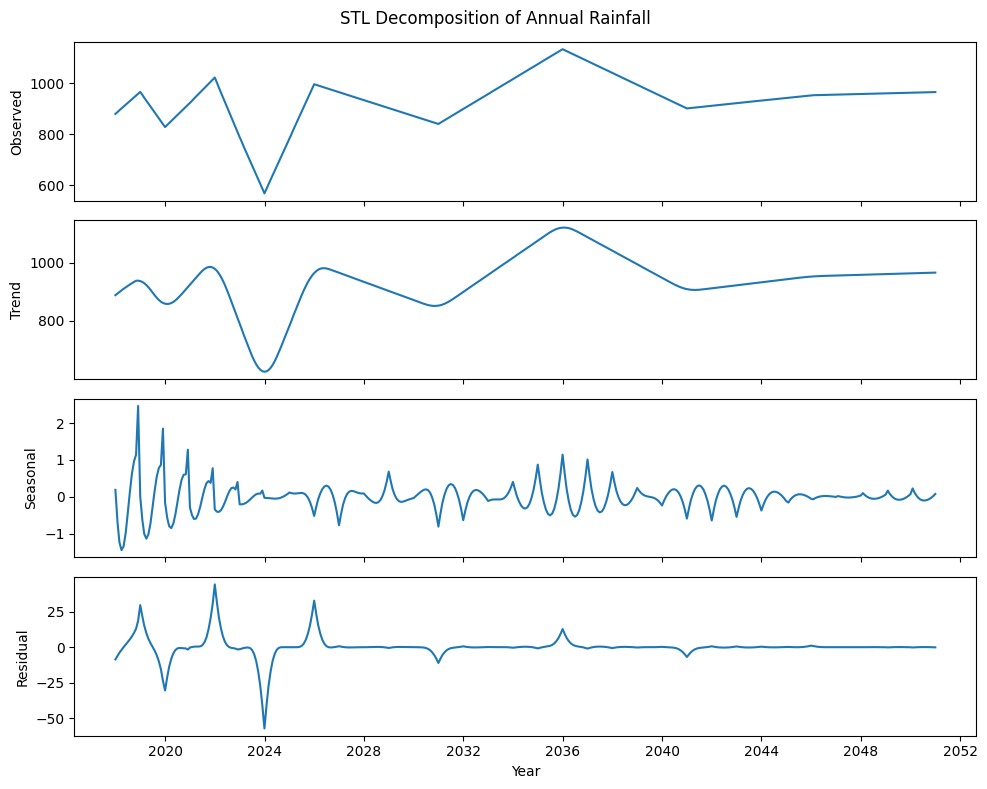

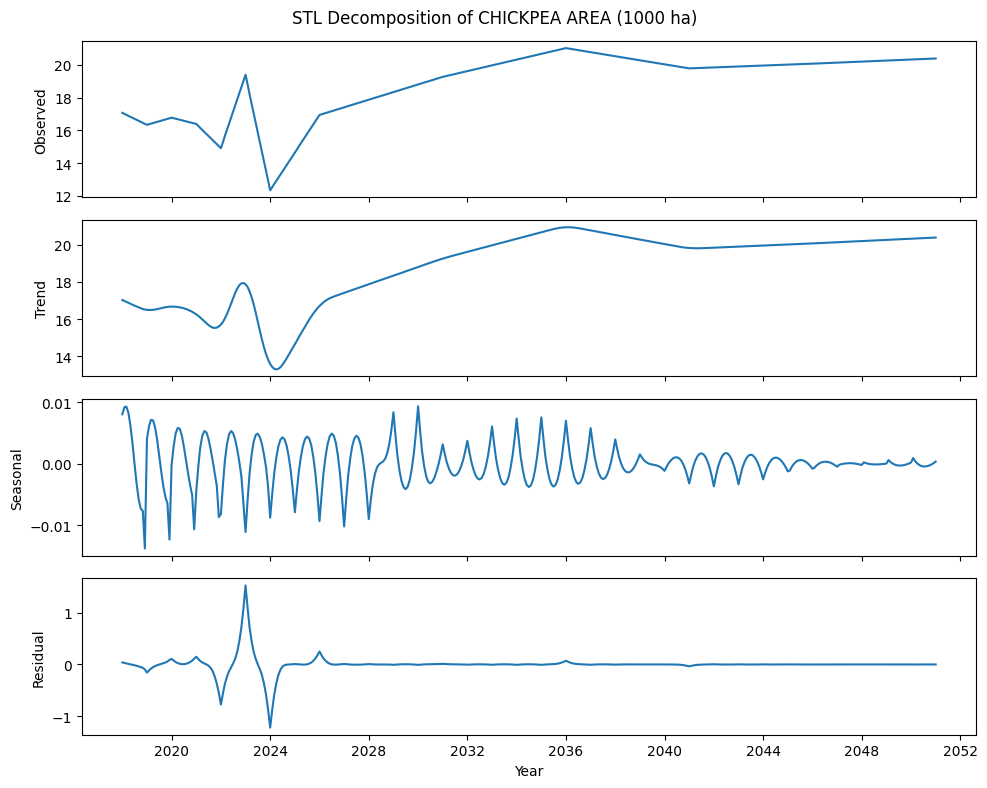

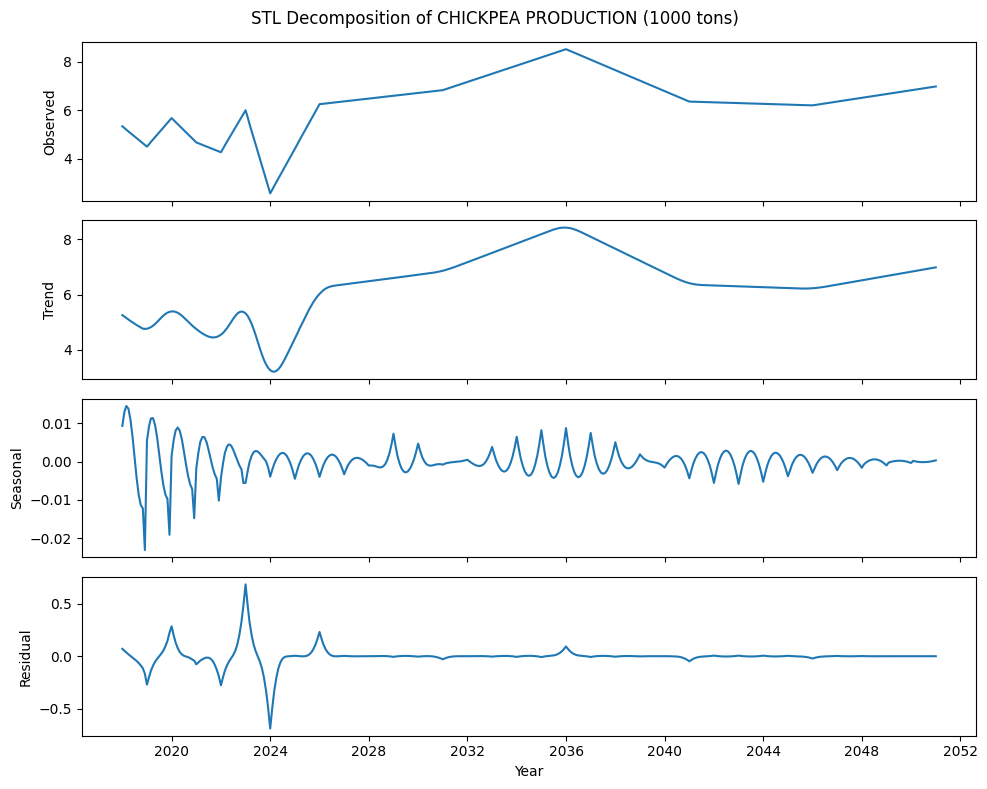

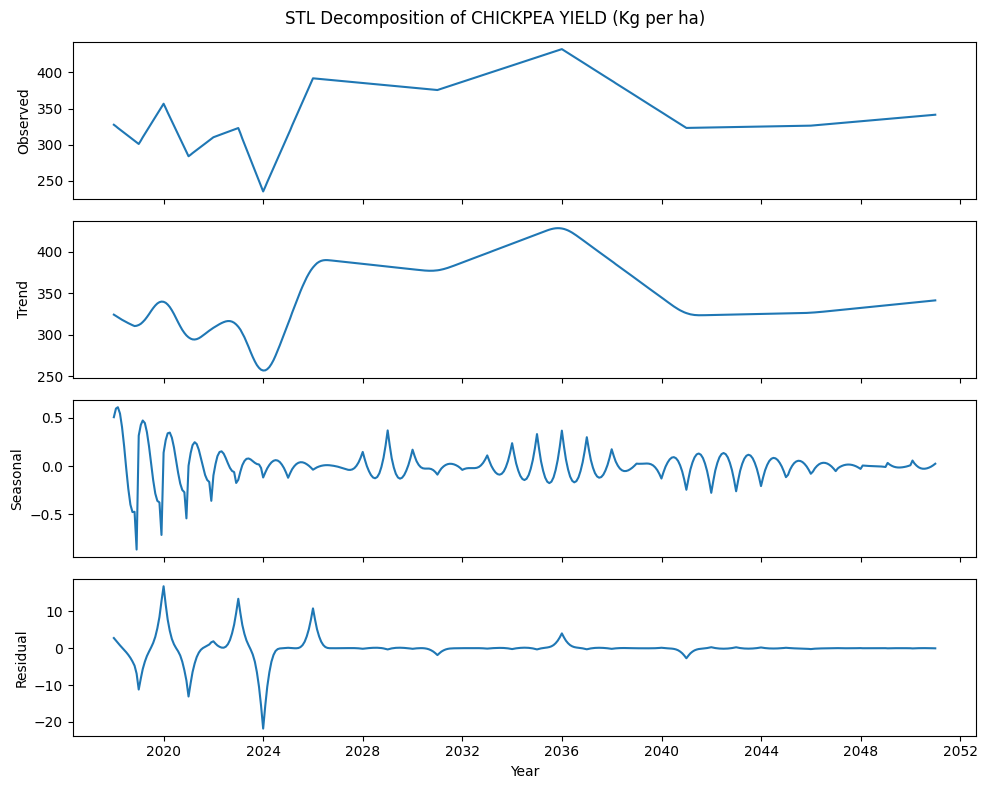

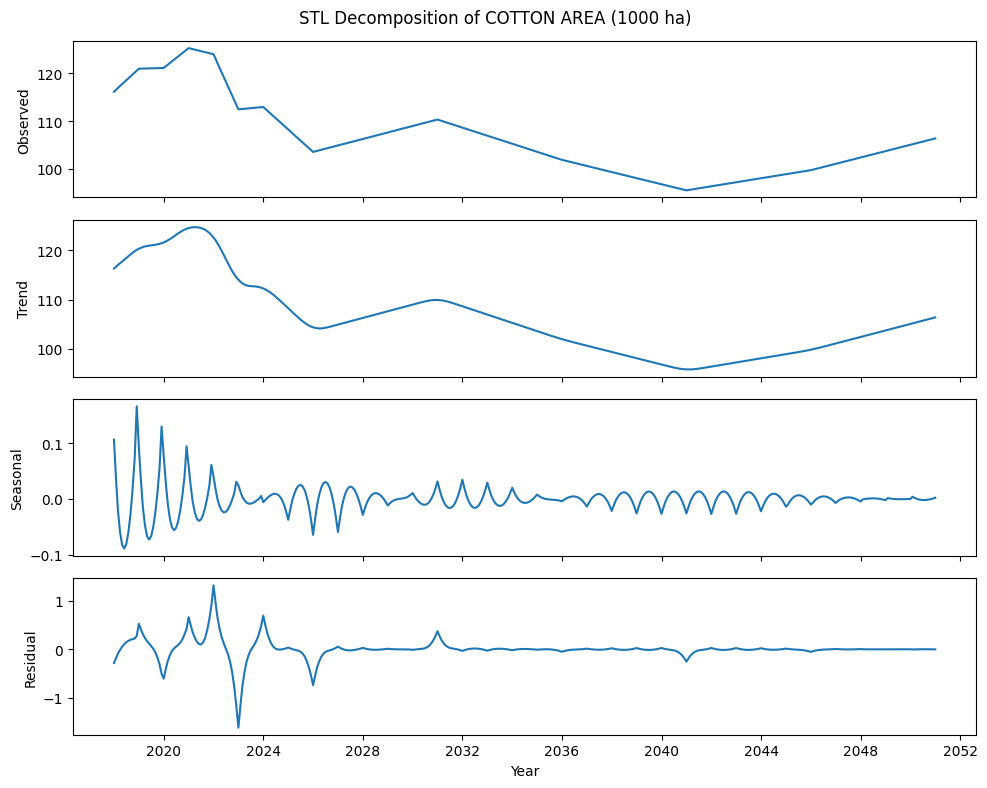

...

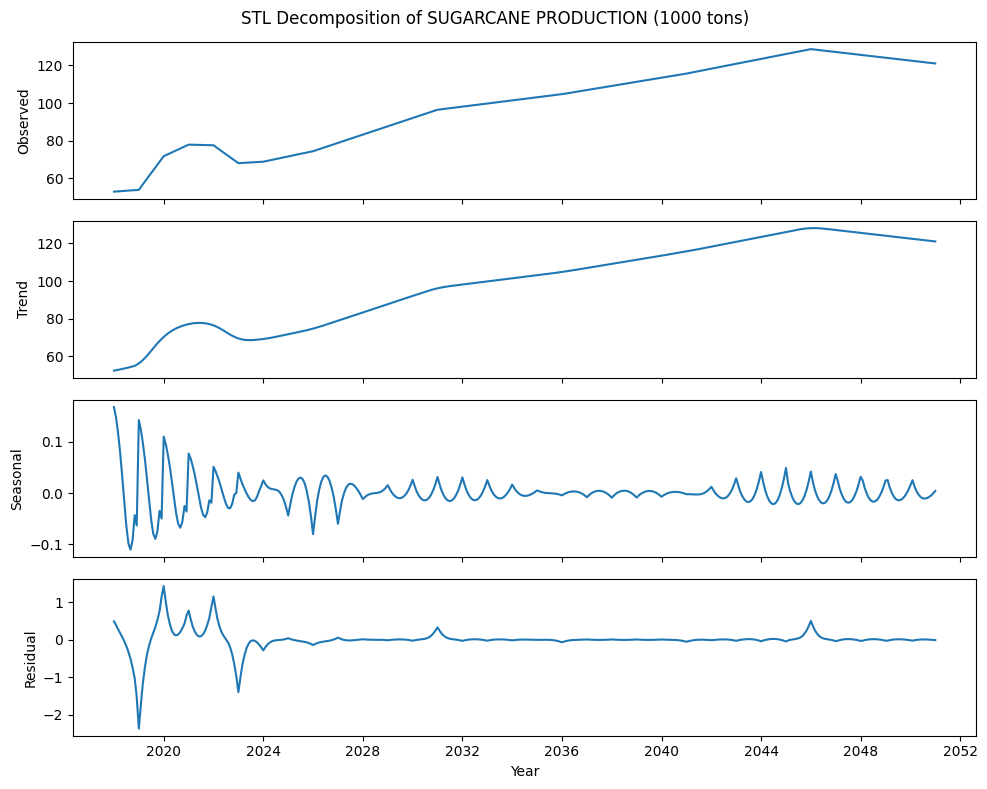

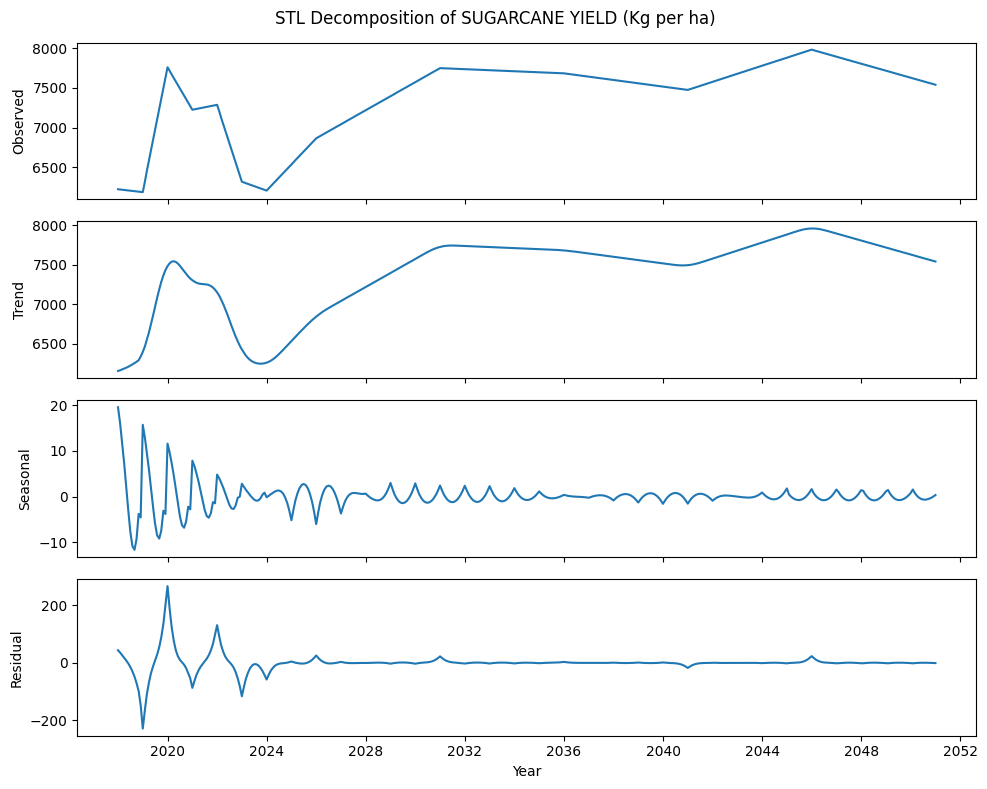

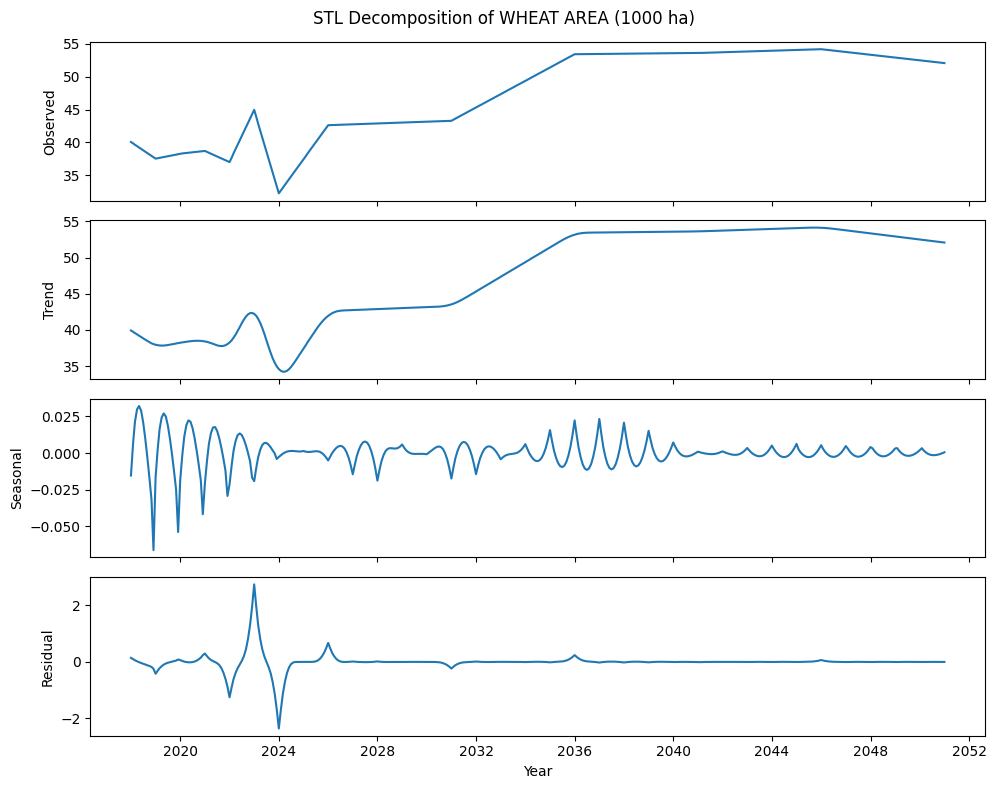

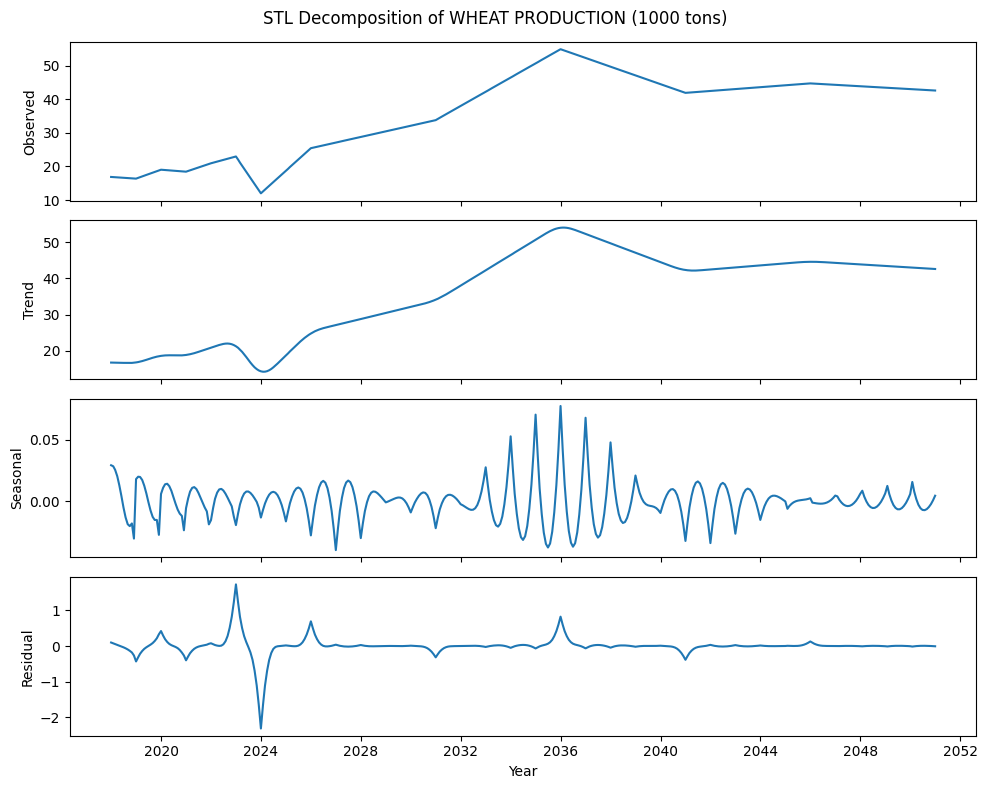

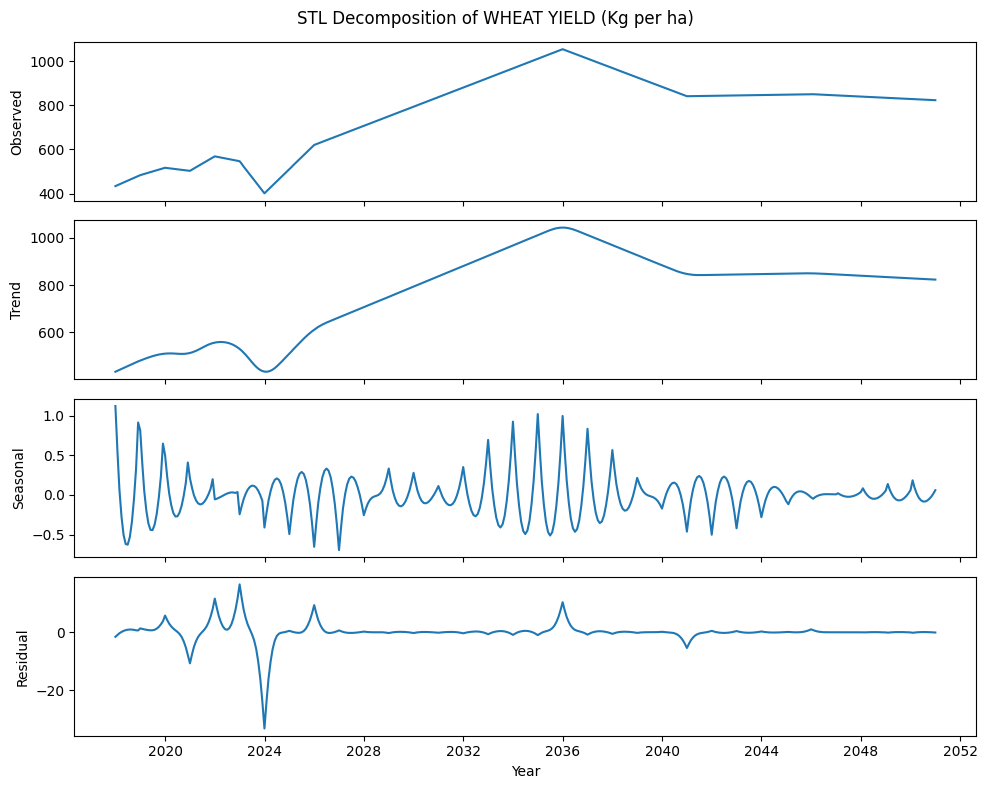

In [ ]:
import pandas as pd
from statsmodels.tsa.seasonal import STL
import matplotlib.pyplot as plt

# Load the dataset
data = pivoted_df.copy()

# Convert 'Year' to datetime format and set as the index
data['Year'] = pd.to_datetime(data['Year'], format='%Y')
data.set_index('Year', inplace=True)

# Select only numeric columns for STL decomposition
numeric_columns = data.select_dtypes(include=['number']).columns

# Iterate through each numeric column to apply STL decomposition
for column in numeric_columns:
    # Resample yearly data to monthly frequency using interpolation
    yearly_data = data[column].resample('YE').mean()  # Adjust aggregation method if needed
    monthly_data = yearly_data.resample('ME').interpolate()

    # Apply STL decomposition
    stl = STL(monthly_data, seasonal=13)
    result = stl.fit()

    # Plot the decomposition
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(10, 8), sharex=True)
    ax1.plot(result.observed, label='Observed')
    ax1.set_ylabel('Observed')
    ax2.plot(result.trend, label='Trend')
    ax2.set_ylabel('Trend')
    ax3.plot(result.seasonal, label='Seasonal')
    ax3.set_ylabel('Seasonal')
    ax4.plot(result.resid, label='Residual')
    ax4.set_ylabel('Residual')
    ax4.set_xlabel('Year')
    plt.suptitle(f'STL Decomposition of {column}')
    plt.tight_layout()
    plt.show()